## IGO17483 AT1401 3D KP Slc4a11-MCD Lenti-iRFP670-Gluc-Flex(tagBFP) (not activated)
7/10/25 - Data generated from IV transplanted cells - DT treated; data submitted by CHP/EB on 6/25/2025; analyzed by JC 7/10/2025

Analyze global run on cellranger v8 data and create h5_ad files for further analysis - w/o introns

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc

import math
import matplotlib
from matplotlib import pyplot as plt

from pathlib import Path
import anndata

In [2]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')
np.random.seed(1573)   #fix so we can reproduce later

In [3]:
plt.rcParams['svg.fonttype'] = 'none'
plt.rcParams["font.family"] = "Arial"
plt.rcParams['figure.figsize'] = (3,4)

In [4]:
Path("./figures/umapfigures").mkdir(parents=True, exist_ok=True) # generate figures here
Path("./write").mkdir(parents=True, exist_ok=True) # write h5ad here

In [5]:
results_file = 'write/IGO17483-KPSlc4a11MACD-IV-DT.h5ad'  # the file that will store the analysis results

Read in the count matrix into an [`AnnData`](https://anndata.readthedocs.io/en/latest/anndata.AnnData.html) object, which holds many slots for annotations and different representations of the data. It also comes with its own HDF5 file format: `.h5ad`.

In [6]:
adata = sc.read_10x_h5('IGO17483-DT-filtered_feature_bc_matrix.h5', gex_only=False)

reading IGO17483-DT-filtered_feature_bc_matrix.h5
 (0:00:01)


/Users/chanj2/opt/miniconda3/envs/scbackup2/lib/python3.11/site-packages/anndata/_core/anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [7]:
adata.obs

""
AAACCAAAGCTGGAAG-1
AAACCAAAGCTGGACT-1
AAACCAAAGTATGAGA-1
AAACCATTCATGTCAG-1
AAACCATTCCCCATTG-1
...
TGTGTTGAGCTGGACT-1
TGTGTTGAGCTTACCT-1
TGTGTTGAGGAGGTGC-1
TGTGTTGAGGAGGTTG-1


In [8]:
adata.var_names_make_unique()  # this is unnecessary if using `var_names='gene_ids'` in `sc.read_10x_mtx`

## Preprocessing

normalizing counts per cell
    finished (0:00:00)


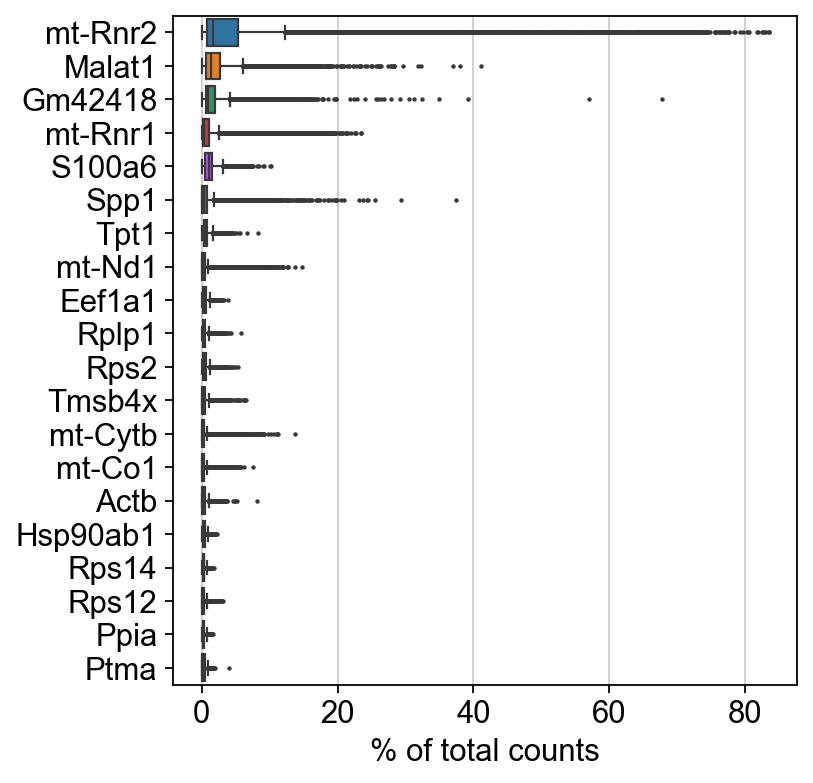

In [9]:
sc.pl.highest_expr_genes(adata, n_top=20, )

In [10]:
sc.pp.filter_cells(adata, min_counts=1500)
sc.pp.filter_cells(adata, min_genes=300)
sc.pp.filter_genes(adata, min_cells=3)

filtered out 1559 cells that have less than 1500 counts
filtered out 89 cells that have less than 300 genes expressed
filtered out 30466 genes that are detected in less than 3 cells


In [11]:
adata.var['mt'] = adata.var_names.str.startswith('mt-') # annotate the group of mitochondrial genes as 'MT'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

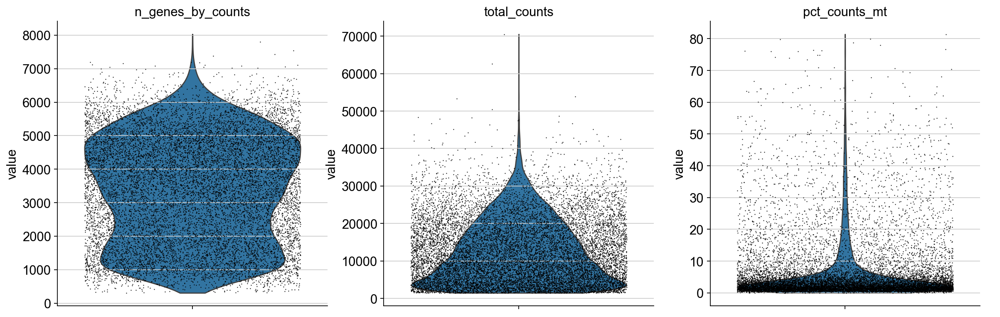

In [12]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True, rotation=90)

(array([   7.,   17.,   47.,  208., 1230., 3962., 4504., 2644.,  568.,
         159.]),
 array([0.73231337, 0.75465781, 0.77700226, 0.7993467 , 0.82169114,
        0.84403558, 0.86638003, 0.88872447, 0.91106891, 0.93341335,
        0.95575779]),
 <BarContainer object of 10 artists>)

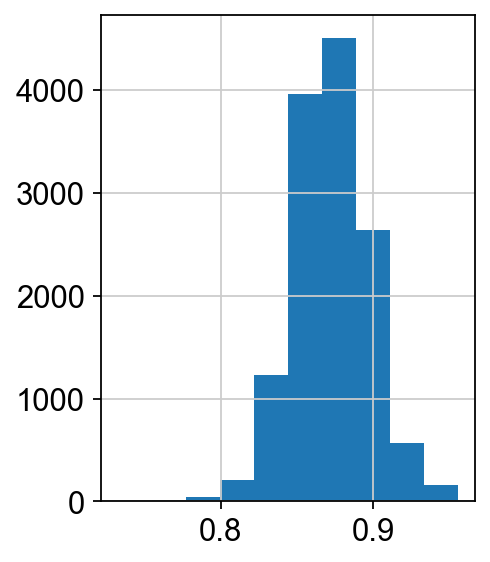

In [13]:
adata.obs["log10GenesPerUMI"] = adata.obs['n_genes_by_counts'].apply(math.log10) / adata.obs['total_counts'].apply(math.log10)
matplotlib.pyplot.hist(adata.obs["log10GenesPerUMI"])

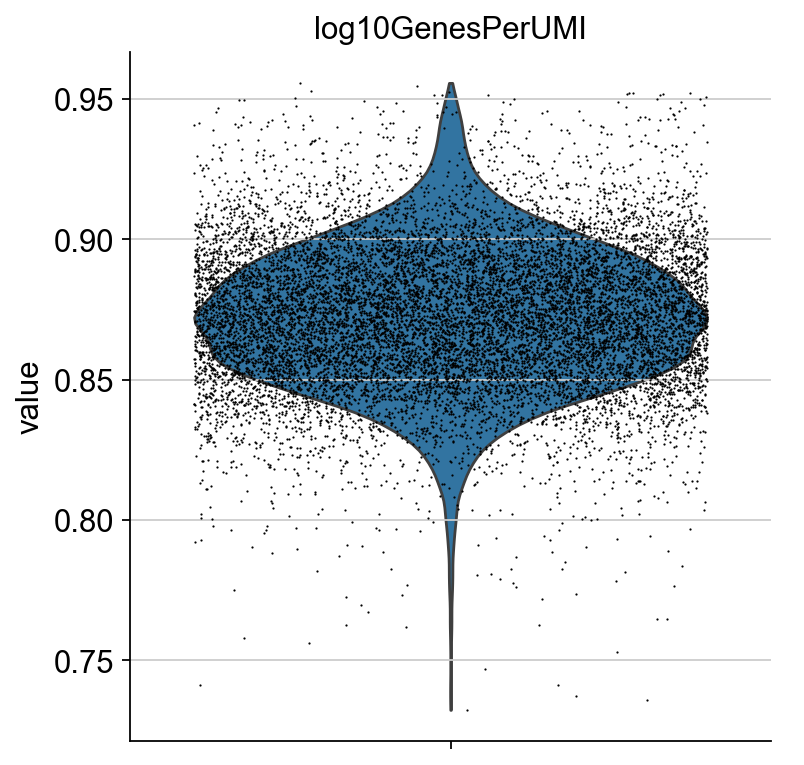

In [14]:
sc.pl.violin(adata, ['log10GenesPerUMI'],
             jitter=0.4, multi_panel=True, rotation=90)

In [15]:
#Filter by Log10GenesPerUMI
adata = adata[adata.obs.log10GenesPerUMI >= 0.8,:]

In [16]:
adata = adata[adata.obs.pct_counts_mt <= 20, :]

## Run Demultiplexing

## set highly variable genes before moving all mean to 0

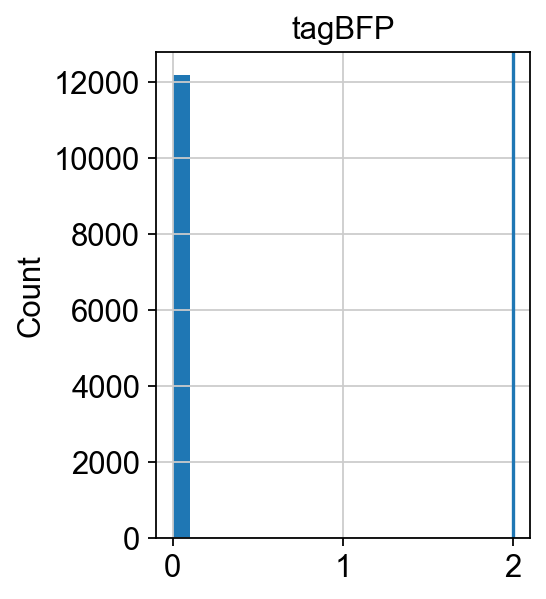

In [17]:
import matplotlib.pyplot as plt
_ = plt.hist(adata.X[:,adata.var.index.isin(['tagBFP'])].toarray())
plt.ylabel("Count")
plt.title("tagBFP")
plt.axvline(x=2)
plt.show()

In [18]:
adata.obs['tagBFP_count'] = adata.X[:,adata.var.index.isin(['tagBFP'])].toarray()

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_49533/2499316847.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['tagBFP_count'] = adata.X[:,adata.var.index.isin(['tagBFP'])].toarray()


In [19]:
adata.var.index

Index(['Xkr4', 'Gm37686', 'Gm19938', 'Rp1', 'Sox17', 'Gm6085', 'Gm6119',
       'Gm6123', 'Mrpl15', 'Gm37144',
       ...
       'RF00004', 'CAAA01147332.1', 'EGFP', 'Cre', 'ERT', 'iDTR', 'GLuc',
       'CLuc', 'tagBFP', 'iRFP670'],
      dtype='object', length=24384)

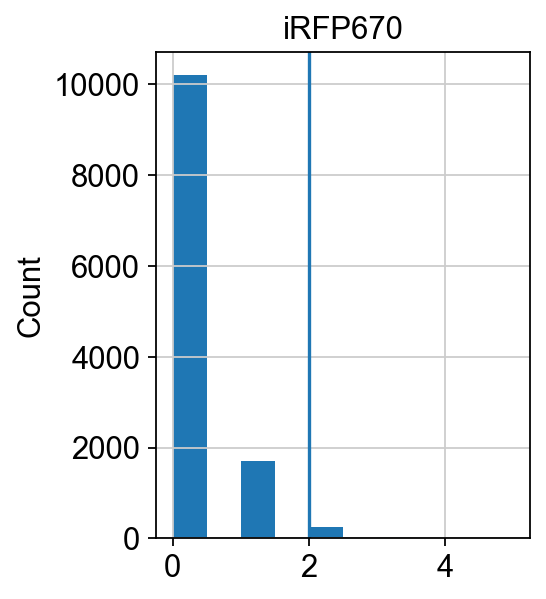

In [20]:
import matplotlib.pyplot as plt
_ = plt.hist(adata.X[:,adata.var.index.isin(['iRFP670'])].toarray())
plt.ylabel("Count")
plt.title("iRFP670")
plt.axvline(x=2)
plt.show()

In [21]:
adata.obs['iRFP670_count'] = adata.X[:,adata.var.index.isin(['iRFP670'])].toarray()

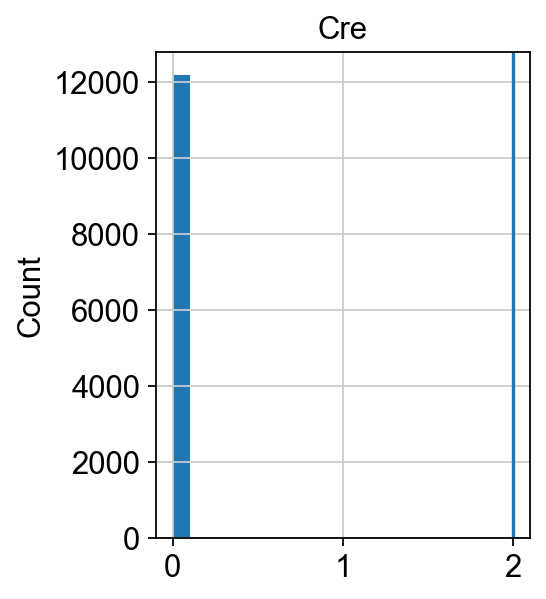

In [22]:
import matplotlib.pyplot as plt
_ = plt.hist(adata.X[:,adata.var.index.isin(['Cre'])].toarray())
plt.ylabel("Count")
plt.title("Cre")
plt.axvline(x=2)
plt.show()

In [23]:
adata.obs['Cre_count'] = adata.X[:,adata.var.index.isin(['Cre'])].toarray()

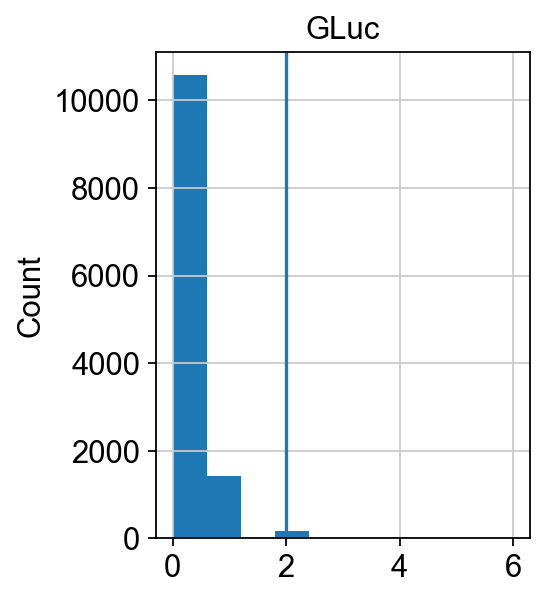

In [24]:
import matplotlib.pyplot as plt
_ = plt.hist(adata.X[:,adata.var.index.isin(['GLuc'])].toarray())
plt.ylabel("Count")
plt.title("GLuc")
plt.axvline(x=2)
plt.show()

In [25]:
adata.obs['GLuc_count'] = adata.X[:,adata.var.index.isin(['GLuc'])].toarray()

## Process ambient RNA

In [26]:
import logging

import anndata2ri
import rpy2.rinterface_lib.callbacks as rcb
import rpy2.robjects as ro

rcb.logger.setLevel(logging.ERROR)
ro.pandas2ri.activate()
anndata2ri.activate()

%load_ext rpy2.ipython

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_49533/3667344255.py:9: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()


In [27]:
import rpy2.robjects as robjects
robjects.r('library(SoupX)')


    an issue that caused a segfault when used with rpy2:
    https://github.com/rstudio/reticulate/pull/1188
    Make sure that you use a version of that package that includes
    the fix.
    

array(['SoupX', 'tools', 'stats', 'graphics', 'grDevices', 'utils',
       'datasets', 'methods', 'base'], dtype='<U9')

In [28]:
adata_pp = adata.copy()
sc.pp.normalize_per_cell(adata_pp)
sc.pp.log1p(adata_pp)

normalizing by total count per cell


/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_49533/1597906230.py:2: FutureWarning: Use sc.pp.normalize_total instead
  sc.pp.normalize_per_cell(adata_pp)


    finished (0:00:00): normalized adata.X and added
    'n_counts', counts per cell before normalization (adata.obs)


/Users/chanj2/opt/miniconda3/envs/scbackup2/lib/python3.11/site-packages/scanpy/preprocessing/_simple.py:591: FutureWarning: Use sc.pp.normalize_total instead
  normalize_per_cell(


In [29]:
sc.pp.pca(adata_pp)
sc.pp.neighbors(adata_pp)
sc.tl.leiden(adata_pp, key_added="soupx_groups")

# Preprocess variables for SoupX
soupx_groups = adata_pp.obs["soupx_groups"]

computing PCA
    with n_comps=50
    finished (0:00:15)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:24)
running Leiden clustering


/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_49533/1913318786.py:3: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata_pp, key_added="soupx_groups")


    finished: found 25 clusters and added
    'soupx_groups', the cluster labels (adata.obs, categorical) (0:00:01)


In [30]:
del adata_pp

In [31]:
cells = adata.obs_names
genes = adata.var_names
data = adata.X.T

In [32]:
adata_raw = sc.read_10x_h5(
    filename="IGO17483-DT-raw_feature_bc_matrix.h5",)
adata_raw.var_names_make_unique()
adata_raw=adata_raw[cells, genes]
data_tod = adata_raw.X.T

reading IGO17483-DT-raw_feature_bc_matrix.h5


/Users/chanj2/opt/miniconda3/envs/scbackup2/lib/python3.11/site-packages/anndata/_core/anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


 (0:00:04)


/Users/chanj2/opt/miniconda3/envs/scbackup2/lib/python3.11/site-packages/anndata/_core/anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [33]:
del adata_raw

In [34]:
from rpy2.robjects import r, globalenv
from rpy2.robjects import pandas2ri
import rpy2.robjects.numpy2ri
from scipy import sparse
import numpy as np

# Enable automatic pandas and numpy conversion (if needed)
pandas2ri.activate()
rpy2.robjects.numpy2ri.activate()

# Assign your Python variables to R environment
globalenv['data'] = data           # Assuming a sparse matrix in R-compatible format
globalenv['data_tod'] = data_tod   # Also sparse
globalenv['genes'] = genes         # A character vector (row names)
globalenv['cells'] = cells         # A character vector (column names)
globalenv['soupx_groups'] = soupx_groups  # A named factor or dataframe with clustering

# Now run the R code
r("""
library(SoupX)

# Assign row and column names
rownames(data) <- genes
colnames(data) <- cells

# Convert to sparseMatrix if not already
data <- as(data, "sparseMatrix")
data_tod <- as(data_tod, "sparseMatrix")

# Create SoupChannel object
sc <- SoupChannel(data_tod, data, calcSoupProfile = FALSE)

# Create soup profile dataframe
soupProf <- data.frame(row.names = rownames(data), 
                       est = rowSums(data)/sum(data), 
                       counts = rowSums(data))
sc <- setSoupProfile(sc, soupProf)

# Add clustering information
sc <- setClusters(sc, soupx_groups)

# Estimate contamination
sc <- autoEstCont(sc, doPlot = FALSE)

# Extract soup profile
soup_profile <- sc$soupProfile

# Get adjusted counts
out <- adjustCounts(sc, roundToInt = TRUE)
""")


<Compressed Sparse Column sparse matrix of dtype 'float64'
	with 43739678 stored elements and shape (24384, 12197)>

In [35]:
soup_profile = globalenv['soup_profile']  # This is likely an R data.frame
out = globalenv['out']                    # This will be a sparse matrix (dgCMatrix)

In [36]:
adata.layers["counts"] = adata.X
adata.layers["soupX_counts"] = out.T
#adata.X = adata.layers["soupX_counts"] # has the soupX_counts
adata.X = adata.layers["counts"]

In [37]:
print(f"Total number of genes: {adata.n_vars}")

# Min 20 cells - filters out 0 count genes
sc.pp.filter_genes(adata, min_cells=20)
print(f"Number of genes after cell filter: {adata.n_vars}")

Total number of genes: 24384
filtered out 6376 genes that are detected in less than 20 cells
Number of genes after cell filter: 18008


In [38]:
adata

AnnData object with n_obs × n_vars = 12197 × 18008
    obs: 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log10GenesPerUMI', 'tagBFP_count', 'iRFP670_count', 'Cre_count', 'GLuc_count'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    layers: 'counts', 'soupX_counts'

In [39]:
adata.write(results_file, compression='gzip')

## Doublet Detection

In [40]:
import rpy2.robjects as robjects
robjects.r("""
library(SoupX)
library(scater)
library(scDblFinder)
library(BiocParallel)
""")

array(['BiocParallel', 'scDblFinder', 'scater', 'ggplot2', 'scuttle',
       'SingleCellExperiment', 'SummarizedExperiment', 'Biobase',
       'GenomicRanges', 'GenomeInfoDb', 'IRanges', 'S4Vectors',
       'BiocGenerics', 'stats4', 'MatrixGenerics', 'matrixStats',
       'Matrix', 'SoupX', 'tools', 'stats', 'graphics', 'grDevices',
       'utils', 'datasets', 'methods', 'base'], dtype='<U20')

In [41]:
data_mat = adata.X.T

In [42]:
from rpy2.robjects import r, globalenv

# Assign your Python matrix to the R environment
globalenv['data_mat'] = data_mat  # Ensure this is a matrix-like object compatible with R

# Run the R commands
r("""
library(SingleCellExperiment)
library(scDblFinder)

set.seed(157)

# Create SCE and run scDblFinder
sce <- scDblFinder(
    SingleCellExperiment(
        list(counts = data_mat)
    )
)

# Extract outputs
doublet_score <- sce$scDblFinder.score
doublet_class <- sce$scDblFinder.class
""")


['doublet', 'singlet', 'doublet', 'singlet', 'singlet', ..., 'singlet', 'singlet', 'singlet', 'singlet', 'singlet']
Length: 12197
Categories (2, object): ['singlet', 'doublet']

In [43]:
doublet_score = globalenv['doublet_score']  # This is a numeric R vector
doublet_class = globalenv['doublet_class']  # This is a factor (R character or factor vector)

In [44]:
adata.obs["scDblFinder_score"] = doublet_score
adata.obs["scDblFinder_class"] = doublet_class
adata.obs.scDblFinder_class.value_counts()

scDblFinder_class
singlet    10429
doublet     1768
Name: count, dtype: int64

In [45]:
# remove doublets
adata = adata[adata.obs.scDblFinder_class.isin(['singlet']),:]

## Set Groups

In [46]:
#Set groups
adata.obs['Classification'] = 'IV'
adata.obs['Group'] = 'DT'

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_49533/1619608337.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['Classification'] = 'IV'


In [47]:
adata.layers['counts']=adata.X.copy()

In [48]:
sc.pp.normalize_total(adata, target_sum=1e4)

normalizing counts per cell
    finished (0:00:00)


Logarithmize the data:

In [49]:
sc.pp.log1p(adata)

In [50]:
sc.pp.highly_variable_genes(adata) #batch_key=Classification

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


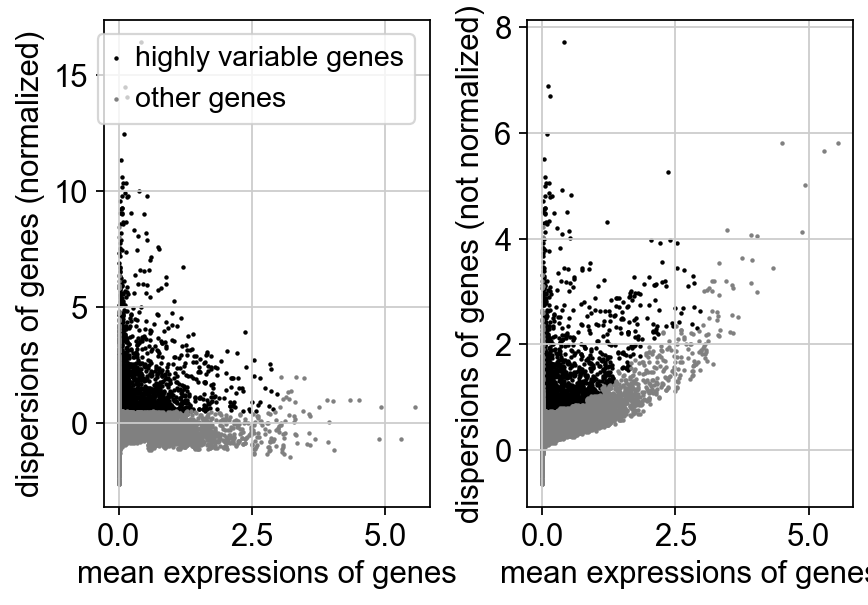

In [51]:
sc.pl.highly_variable_genes(adata)

In [52]:
#will need to update this after realignment
#Ensure marker genes aren't making an impact to highly variable gene analysis downstream
adata.var.highly_variable['EGFP'] = False
adata.var.highly_variable['mScarlet'] = False
adata.var.highly_variable['Cre'] = False
adata.var.highly_variable['ERT'] = False
adata.var.highly_variable['iDTR'] = False
adata.var.highly_variable['tagBFP'] = False
adata.var.highly_variable['mKate2'] = False
adata.var.highly_variable['Akaluc'] = False
adata.var.highly_variable['tdTomato'] = False
adata.var.highly_variable['GLuc'] = False
adata.var.highly_variable['CLuc'] = False
adata.var.highly_variable['iRFP670'] = False

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_49533/3353793633.py:3: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata.var.highly_variable['EGFP'] = False
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_49533/335379

In [53]:
adata.raw = adata

In [54]:
adata.write('write/allmice-IGO17483.h5ad', compression='gzip')

In [55]:
sc.pp.scale(adata, max_value=10)

/Users/chanj2/opt/miniconda3/envs/scbackup2/lib/python3.11/functools.py:909: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)


## Principal component analysis

In [56]:
sc.tl.pca(adata, svd_solver='arpack', n_comps=150)

computing PCA
    with n_comps=150
    finished (0:00:04)


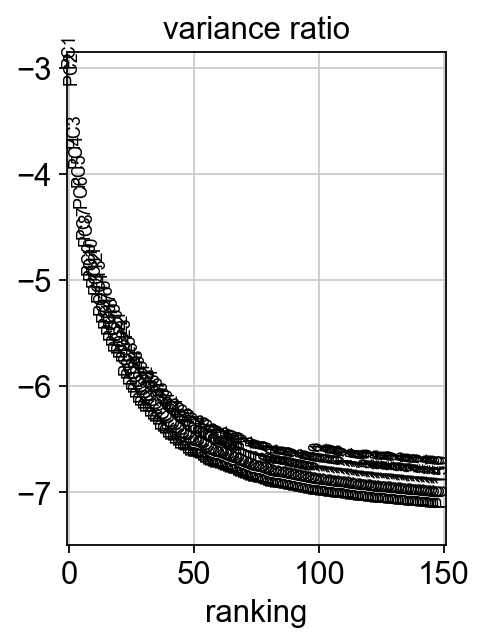

In [57]:
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=150)

Save the result.

In [58]:
adata.write(results_file, compression='gzip')

## Computing the neighborhood graph

In [59]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=50)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)


## Embedding the neighborhood graph

In [60]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:06)


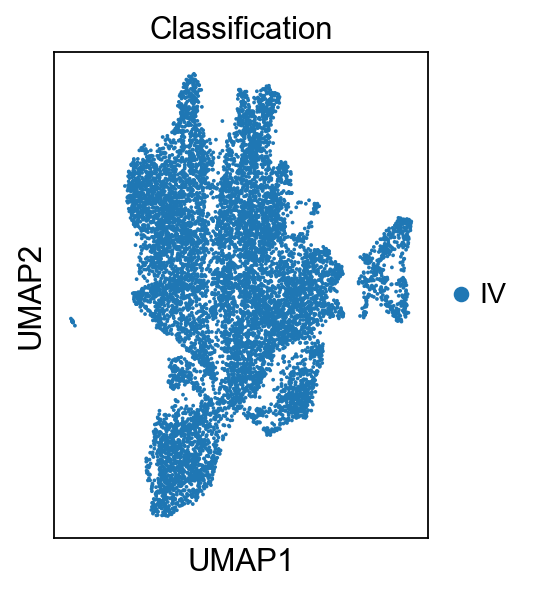

In [61]:
sc.pl.umap(adata, color=['Classification'])

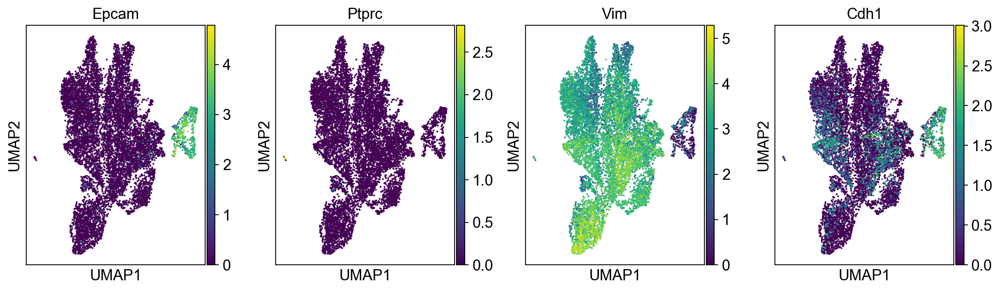

In [62]:
sc.pl.umap(adata, color=['Epcam','Ptprc','Vim', 'Cdh1',]) #'Ptprc','Cdh2'

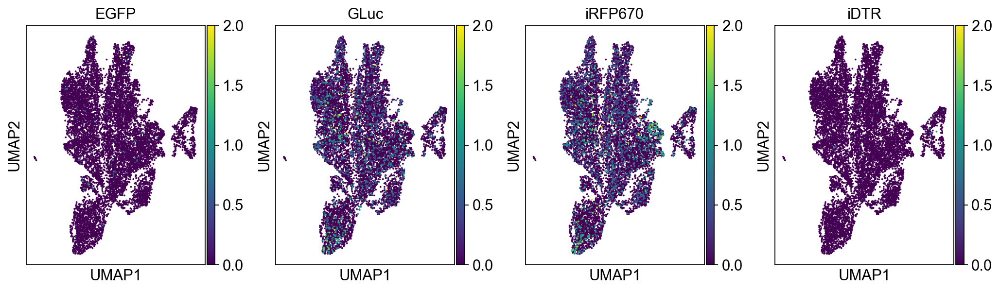

In [63]:
sc.pl.umap(adata, color=['EGFP','GLuc','iRFP670','iDTR'], vmax=2)

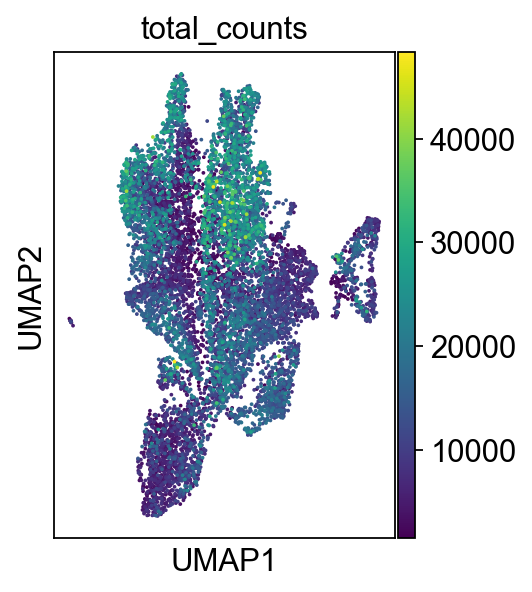

In [64]:
sc.pl.umap(adata, color=['total_counts'])

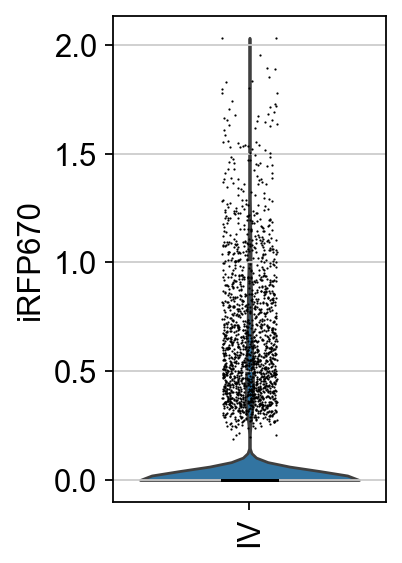

In [65]:
sc.pl.violin(adata, 'iRFP670','Classification',rotation=90)

## Define scoring Functions

In [66]:
# Score Cluster 5 cells
import csv
clusters = {}
clusterkeys = []
HPCS = False

def resetClusters(hpcs = 'cell2020'):
    clusters = {}
    clusterkeys = []
    HPCS = False
    try:
        if hpcs == 'cell2020':         
            with open('./clusters/clusters_cell2020.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = [x for x in row[1:] if x != '']
            for i in range(1,13):
                #if i == 9: continue
                clusterkeys.append('Cluster %i' % i)
            HPCS = 'Cluster 5'
        else:
            raise ValueError
    except ValueError:
        print("%s is an invalid choice" % hpcs)
        raise
    return (clusters, clusterkeys, HPCS)

(clusters, clusterkeys, HPCS) = resetClusters('cell2020')

In [67]:
def scoreAndPlot(ad, excludeList = None, groupby="Classification",rotation=90,numgenes=500,ctlgenes=25):
    #cmap = 'Reds' #colormap
    cmap = 'jet' #colormap
    if excludeList == None:
        for i in clusterkeys:
            if (numgenes > ctlgenes):
                ctlgenes = numgenes
            sc.tl.score_genes(ad, clusters[i][0:numgenes],score_name="%s" % i, ctrl_size=ctlgenes)  
  
        sc.pl.umap(ad, color=clusterkeys, color_map=cmap)
        sc.pl.dotplot(ad, clusterkeys, groupby=groupby, swap_axes=True)

In [68]:
from scipy.stats import ranksums

def HPCSViolinPlot(ad, cluster='0', groupby='leiden', score='Cluster5', save=None, singleGene=False):
    ad.obs['Cl5'] = 'not HPCS'
    ad.obs.loc[ad.obs[groupby].isin([cluster]), 'Cl5'] = 'HPCS'

    if singleGene:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray(),ad[~ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray())[1]
    else:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])].obs[score],ad[ad.obs['Cl5'].isin(['not HPCS'])].obs[score])[1]
    sc.pl.violin(ad, score, groupby='Cl5', xlabel = 'p = ' + str(pvalue), save=save)

computing score 'Cluster 1'
       'Retnla', 'Gm15478', 'Lyz1', 'Slc10a6', 'Gm6166', 'H2-DMb2', 'Bex4',
       'Itih4', '2610028H24Rik', 'Acoxl'],
      dtype='object')
    finished: added
    'Cluster 1', score of gene set (adata.obs).
    2191 total control genes are used. (0:00:00)
computing score 'Cluster 2'
       'Cox6a2', 'Aox3', 'Gm43085', 'Adam19', 'Slc24a4', 'Gm28439', 'Npw',
       'Sftpa1', 'Napsa', 'Igsf9b', 'Slco4c1'],
      dtype='object')
    finished: added
    'Cluster 2', score of gene set (adata.obs).
    2303 total control genes are used. (0:00:00)
computing score 'Cluster 3'
       'Slc6a14', 'Mettl7a2', 'Gm37752', 'AC154734.2', 'Limch1', 'Myct1',
       'Mfsd7c', 'AC154734.1'],
      dtype='object')
    finished: added
    'Cluster 3', score of gene set (adata.obs).
    2286 total control genes are used. (0:00:00)
computing score 'Cluster 4'
       'Aass', 'Tspan11', 'Bex2', 'Filip1', 'Cracr2a', 'Gm12505', 'Tnfsf13',
       'Pde7b'],
      dtype='object')
    fin

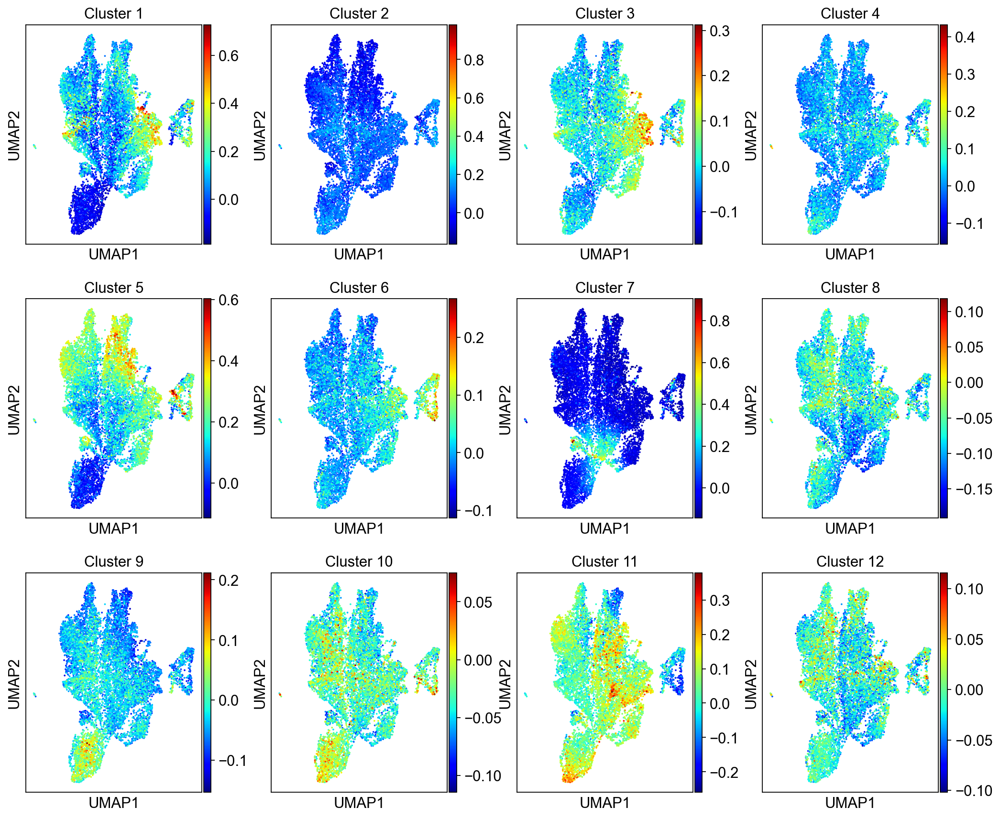

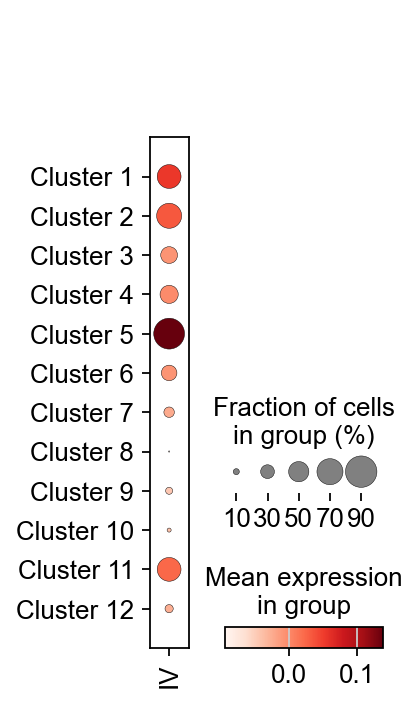

In [69]:
scoreAndPlot(adata, numgenes=100)

## Clustering the neighborhood graph

As with Seurat and many other frameworks, we recommend the Leiden graph-clustering method (community detection based on optimizing modularity) by [Traag *et al.* (2018)](https://scanpy.readthedocs.io/en/latest/references.html#traag18). Note that Leiden clustering directly clusters the neighborhood graph of cells, which we already computed in the previous section.

In [70]:
sc.tl.leiden(adata, resolution=0.15)

running Leiden clustering
    finished: found 6 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


Plot the clusters, which agree quite well with the result of Seurat.

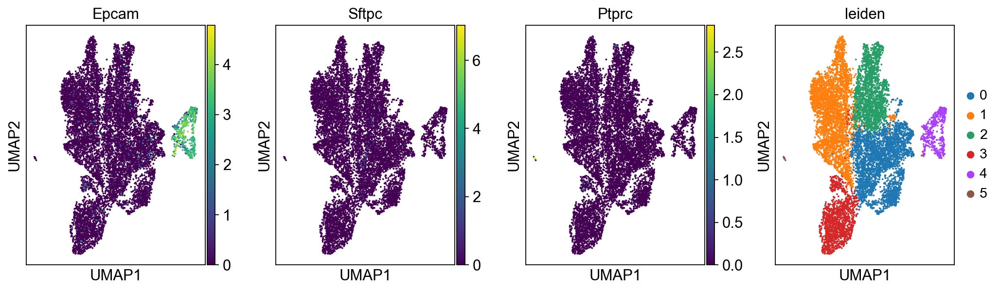

(None,)

In [71]:
sc.pl.umap(adata, color=['Epcam', 'Sftpc', # Tumor cells
                         'Ptprc','leiden']), #immune
                         #  'Cd4', 'Cd8a', #T cell #'Cd3e',
                         # 'Cd19', 'Ms4a1', 'Cd22', # B cell
                         # #'Itgax', 'Il3ra', # Dendritic Cell
                         # 'Ncam1',# 'Ncr1', # NK Cell
                         # 'Cd34', # Hematopoetic stem cell
                         # #'Cd14', 'Cd33', # macrophage
                         # #'Ceacam8' # Granulocyte
                         # 'Itga2b', 'Itgb3', 'Selp', #platelet
                         # #'Gypa',  # erythrocyte
                         # #'Mcam', 'Vcam1', 'Pecam1', 'Sele', # endothelial cell
                         # 'Cd109', 'Wnt5a', 'Kras'])

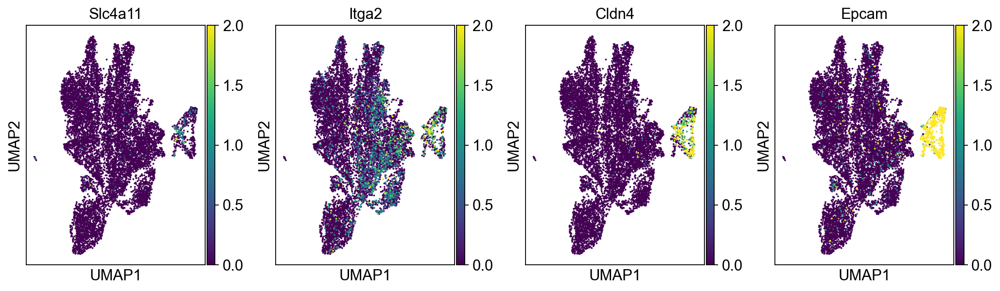

In [72]:
sc.pl.umap(adata, color=['Slc4a11', 'Itga2', 'Cldn4','Epcam'], vmax=2) #'Tigit', 

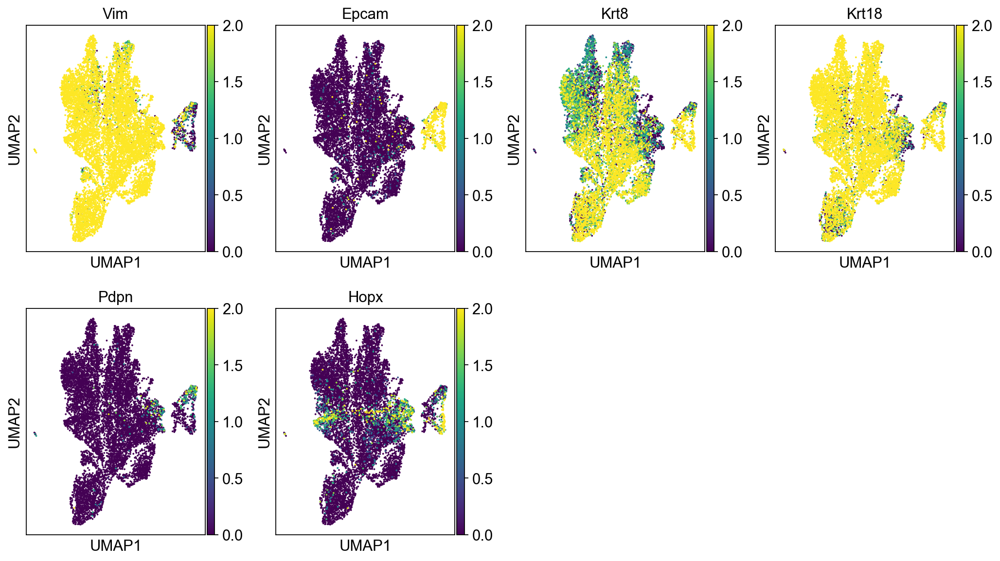

In [73]:
sc.pl.umap(adata, color=['Vim', 'Epcam', 'Krt8', 'Krt18', 'Pdpn', 'Hopx'], vmax=2) #'Pecam1',

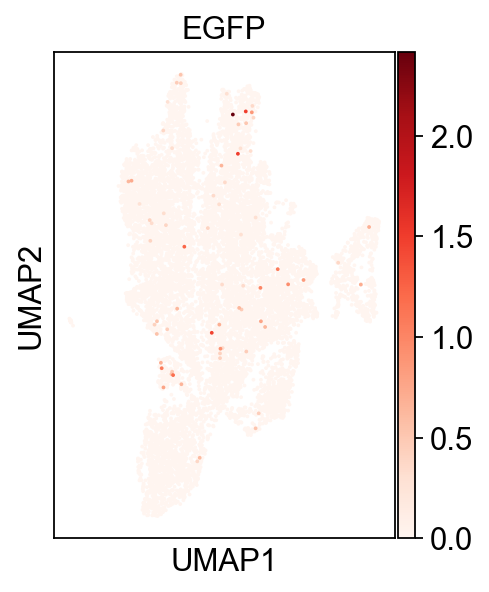

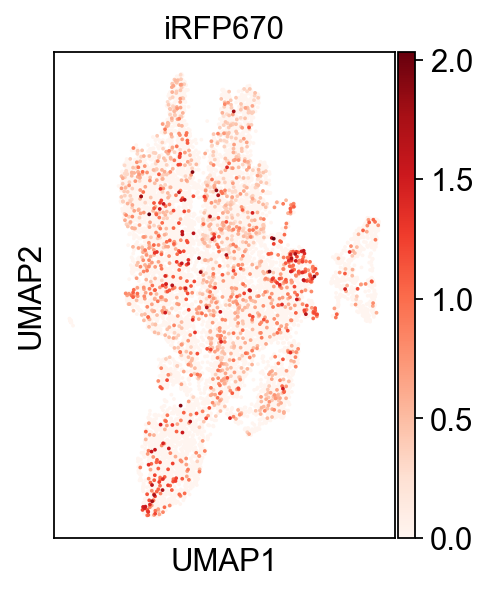

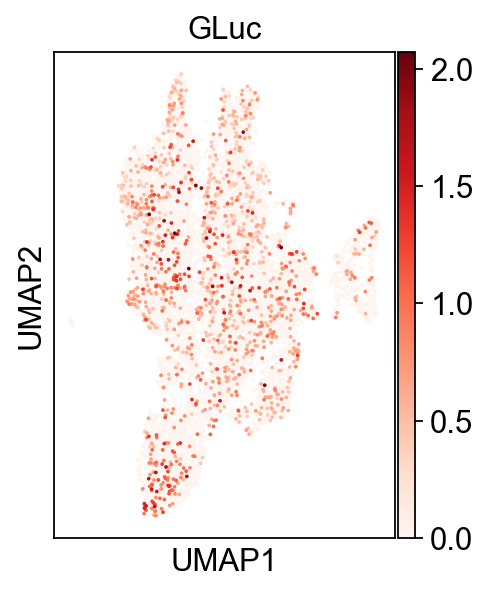

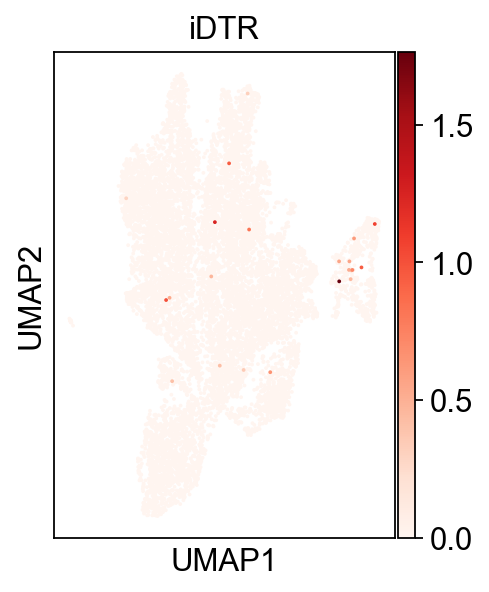

In [74]:
sc.pl.umap(adata, color=['EGFP'], cmap='Reds')
sc.pl.umap(adata, color=['iRFP670'], cmap='Reds')
sc.pl.umap(adata, color=['GLuc'], cmap='Reds')
#sc.pl.umap(adata, color=['mScarlet'], cmap='Reds')
sc.pl.umap(adata, color=['iDTR'], cmap='Reds')

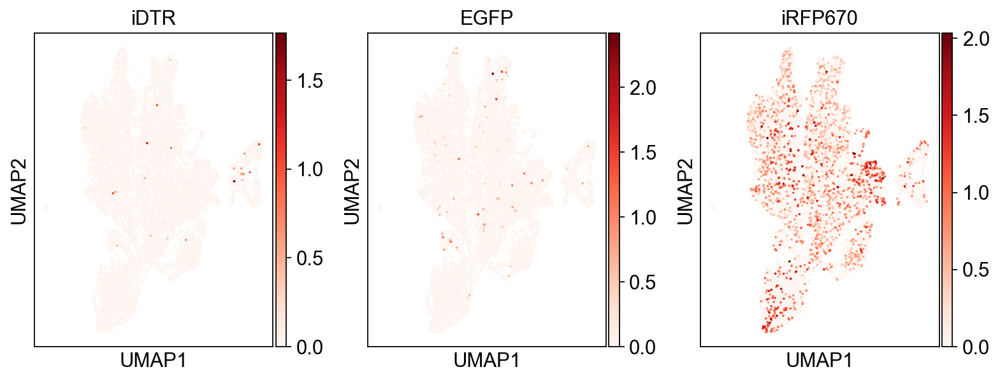

In [75]:
sc.pl.umap(adata, color=['iDTR','EGFP','iRFP670'], cmap='Reds') #'mKate2'

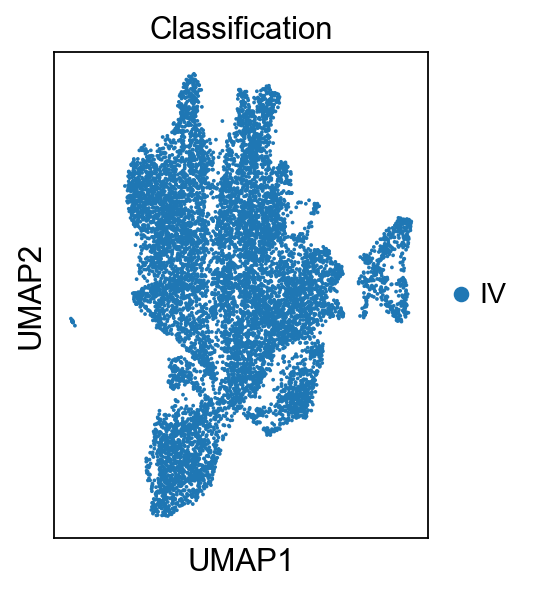

In [76]:
for label in adata.obs['Classification'].unique():
    sc.pl.umap(adata, color='Classification',groups=[label])

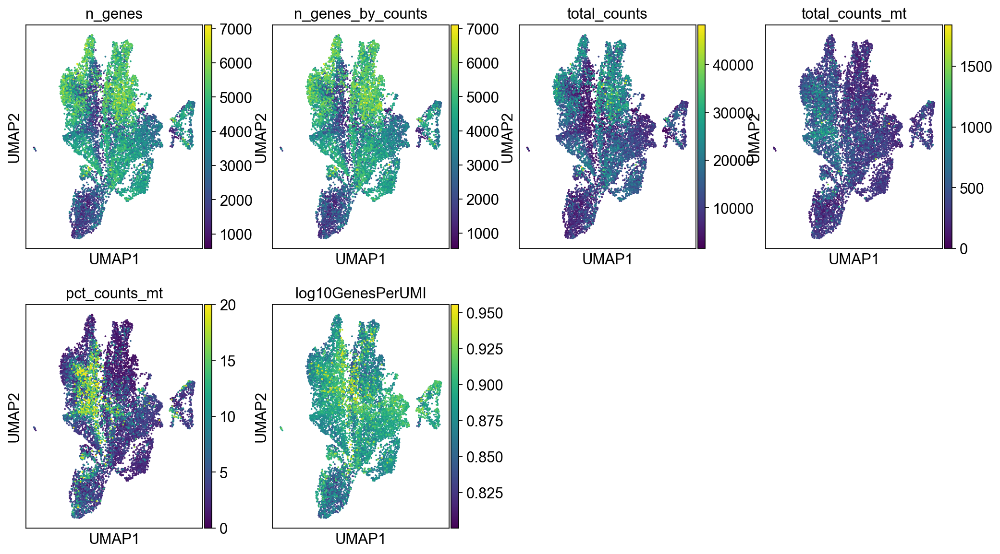

In [77]:
sc.pl.umap(adata,color=['n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt',
       'pct_counts_mt', 'log10GenesPerUMI'])

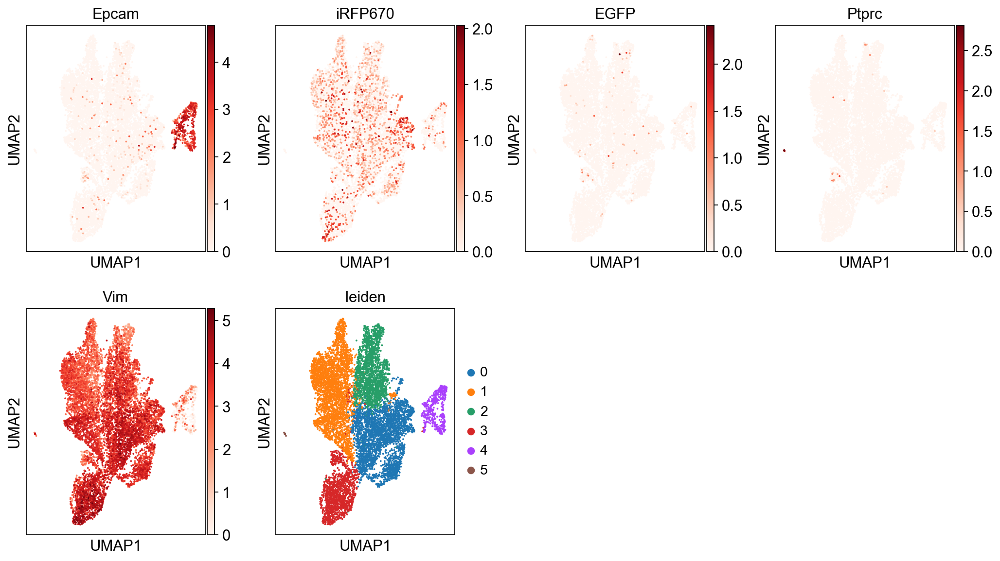

In [78]:
sc.pl.umap(adata, color=['Epcam','iRFP670','EGFP','Ptprc','Vim','leiden',],cmap="Reds")

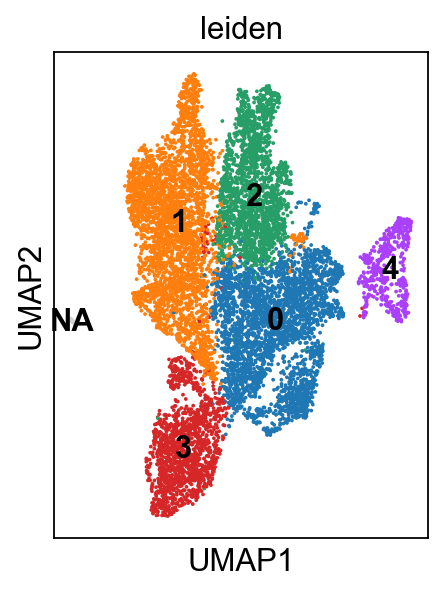

In [79]:
sc.pl.umap(adata, color=['leiden'], groups=['0','1','2','3','4'],legend_loc='on data')

## Select Tumor Cells

In [80]:
# Select only those subset of cells that are useful
adata2 = sc.read('write/allmice-IGO17483.h5ad')
adata = adata2[adata.obs['leiden'].isin(['0','1','2','3','4']),:] # keep tumor cells
del adata2

In [81]:
#fix a bug; 'base' is None but that doesn't seem to have transferred
adata.uns['log1p'] = {}
adata.uns['log1p']['base'] = None

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_49533/2000007.py:2: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns['log1p'] = {}


In [82]:
sc.pp.highly_variable_genes(adata)#, batch_key='Classification')

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [83]:
#Ensure marker genes aren't making an impact to highly variable gene analysis downstream
adata.var.highly_variable['EGFP'] = False
adata.var.highly_variable['mScarlet'] = False
adata.var.highly_variable['Cre'] = False
adata.var.highly_variable['ERT'] = False
adata.var.highly_variable['iDTR'] = False
adata.var.highly_variable['tagBFP'] = False
adata.var.highly_variable['mKate2'] = False
adata.var.highly_variable['Akaluc'] = False
adata.var.highly_variable['tdTomato'] = False
adata.var.highly_variable['GLuc'] = False
adata.var.highly_variable['CLuc'] = False
adata.var.highly_variable['iRFP670'] = False

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_49533/320926811.py:2: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata.var.highly_variable['EGFP'] = False
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_49533/3209268

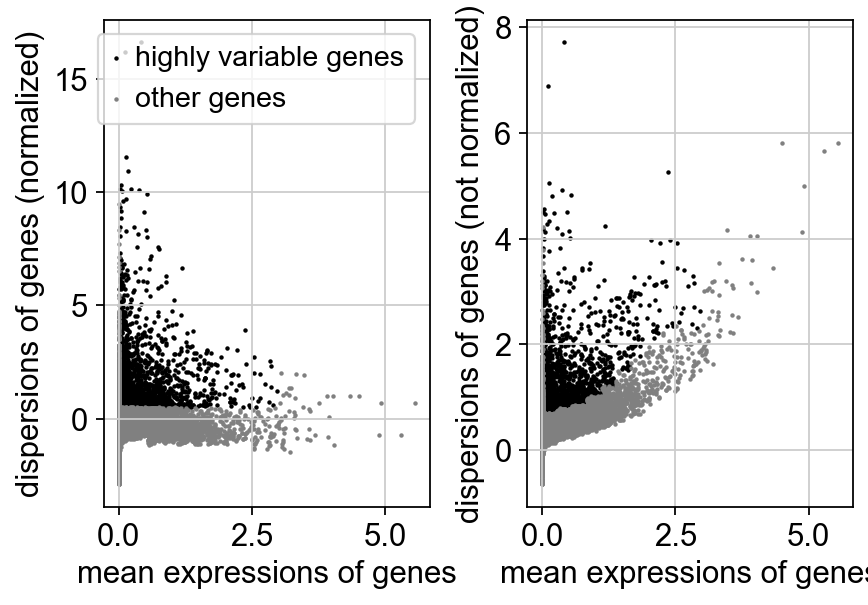

In [84]:
sc.pl.highly_variable_genes(adata)

In [85]:
adata.raw = adata

In [86]:
adata.write('write/allmice-tumor-IGO17483-DT.h5ad', compression='gzip')
#adata = sc.read('write/allmice-tumor.h5ad')

## Now rerun algorithm

In [87]:
adata.obs.Classification.value_counts()

Classification
IV    10411
Name: count, dtype: int64

In [88]:
sc.pp.scale(adata, max_value=10)

/Users/chanj2/opt/miniconda3/envs/scbackup2/lib/python3.11/functools.py:909: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)


## Principal component analysis

In [89]:
sc.tl.pca(adata, svd_solver='arpack', n_comps=150)

computing PCA
    with n_comps=150
    finished (0:00:04)


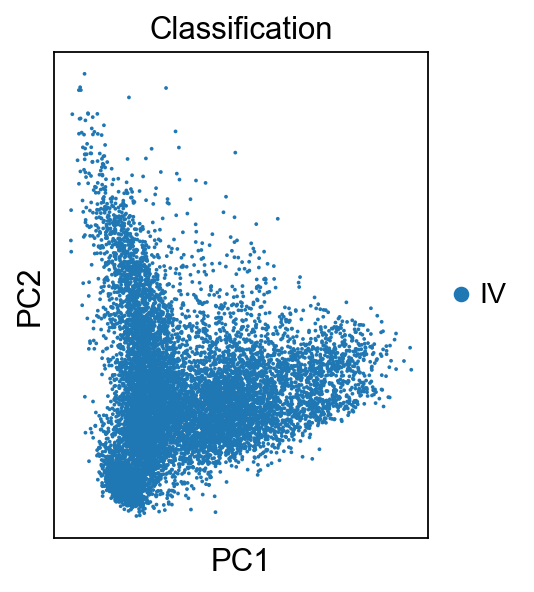

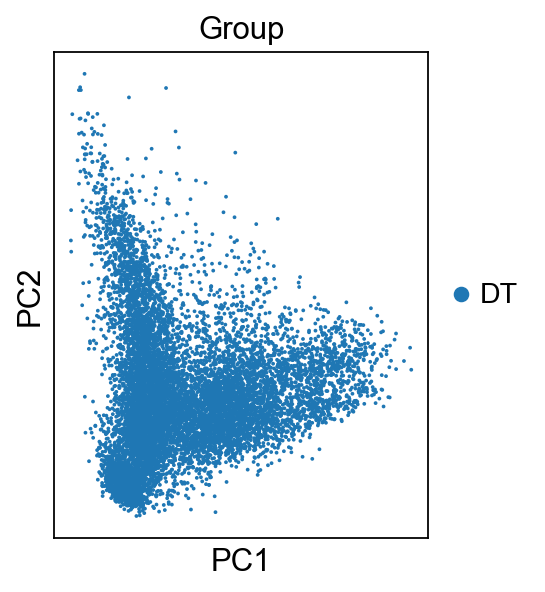

In [90]:
#sc.pl.pca(adata, color='leiden',dimensions=[(0,1)])
sc.pl.pca(adata, color='Classification',dimensions=[(0,1)])
sc.pl.pca(adata, color='Group',dimensions=[(0,1)])

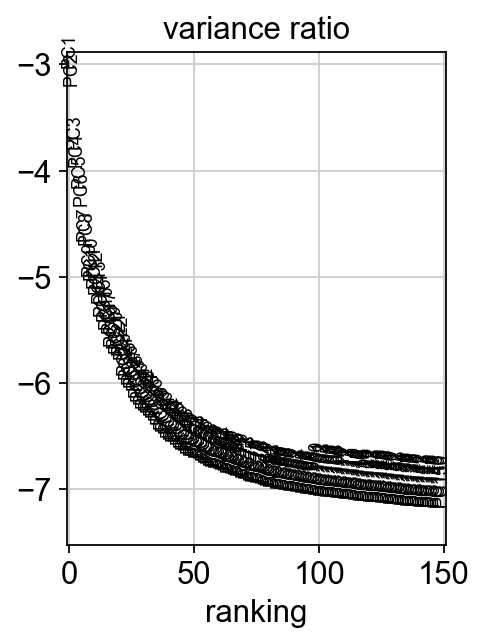

In [91]:
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=150)

Save the result.

In [92]:
adata.write(results_file, compression='gzip')

In [93]:
adata.obs.Classification.value_counts()

Classification
IV    10411
Name: count, dtype: int64

## Computing the neighborhood graph

In [94]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=40)

computing neighbors
    using 'X_pca' with n_pcs = 40
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)


## Embedding the neighborhood graph

In [95]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:05)


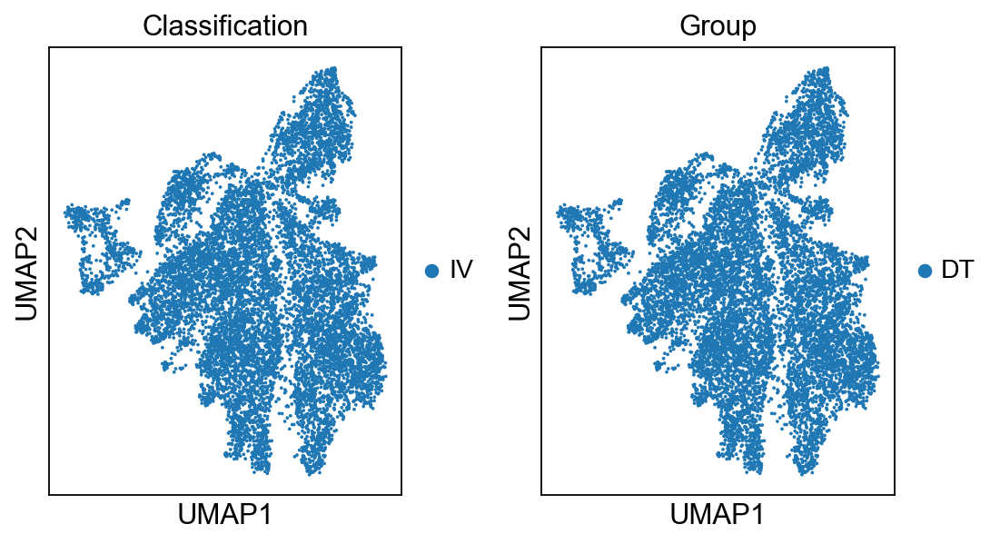

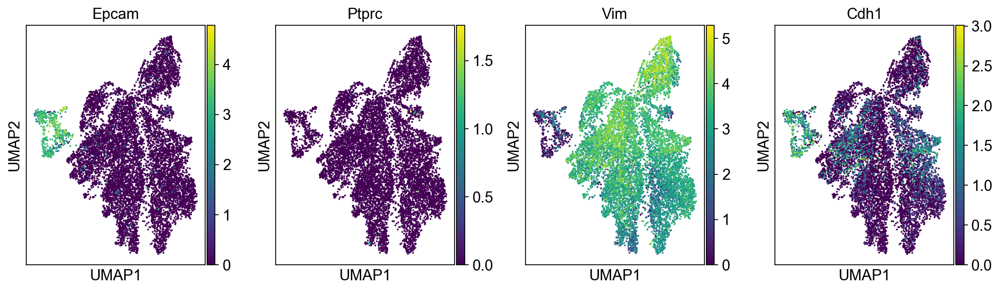

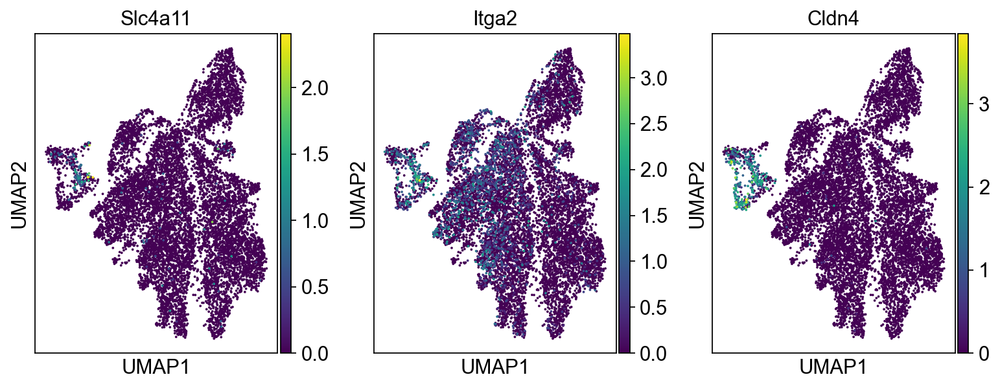

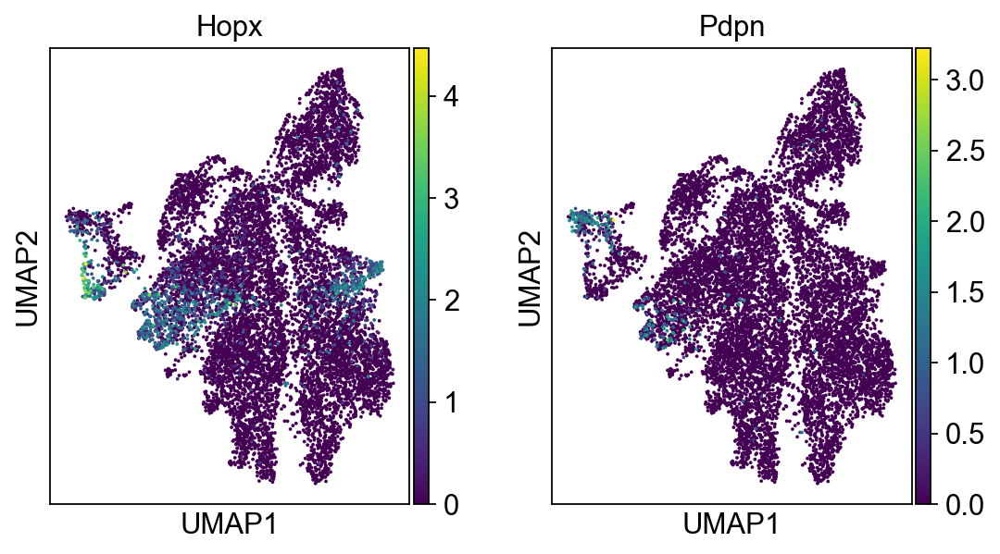

In [96]:
sc.pl.umap(adata, color=['Classification', 'Group'])
#sc.pl.umap(adata, color=['Porcn', 'Lgr5', 'Lgr6','Axin2']) #LGR5 not found #
sc.pl.umap(adata, color=['Epcam', 'Ptprc', 'Vim', 'Cdh1',]) #CDH2 not found #'Cdh2'
sc.pl.umap(adata, color=['Slc4a11', 'Itga2', 'Cldn4']) #, 'Abcb1'
sc.pl.umap(adata, color=['Hopx', 'Pdpn'])
#sc.pl.umap(adata, color=['Cd81', 'Cd19'])
#sc.pl.umap(adata, color=['Trp53','Meg3'], vmax=5)

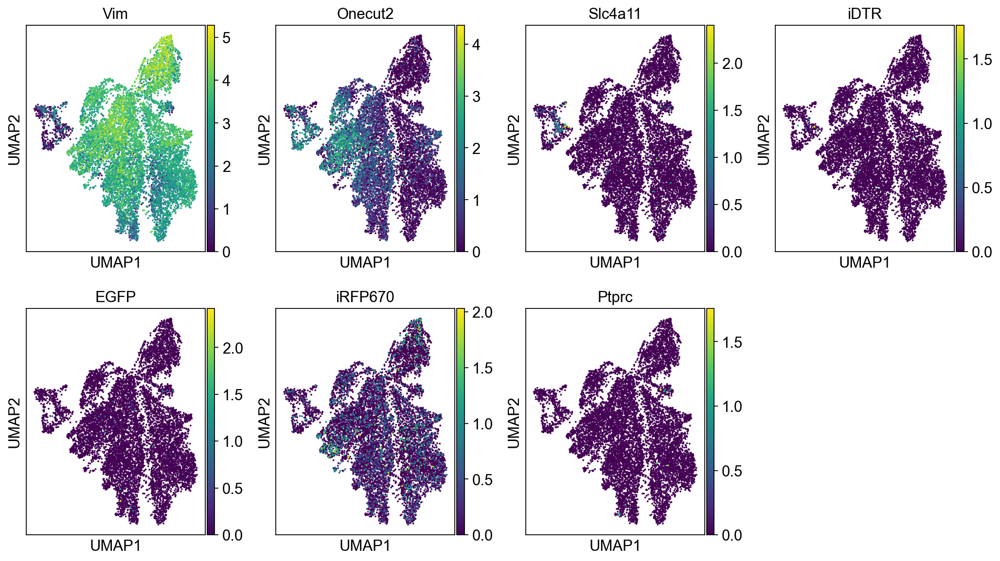

In [97]:
sc.pl.umap(adata, color=['Vim', 'Onecut2', 'Slc4a11', 'iDTR', 'EGFP','iRFP670','Ptprc']) #'Sox11', 

computing score 'Cluster 1'
       'Retnla', 'Gm15478', 'Lyz1', 'Slc10a6', 'Gm6166', 'H2-DMb2', 'Bex4',
       'Itih4', '2610028H24Rik', 'Acoxl'],
      dtype='object')
    finished: added
    'Cluster 1', score of gene set (adata.obs).
    2188 total control genes are used. (0:00:00)
computing score 'Cluster 2'
       'Cox6a2', 'Aox3', 'Gm43085', 'Adam19', 'Slc24a4', 'Gm28439', 'Npw',
       'Sftpa1', 'Napsa', 'Igsf9b', 'Slco4c1'],
      dtype='object')
    finished: added
    'Cluster 2', score of gene set (adata.obs).
    2302 total control genes are used. (0:00:00)
computing score 'Cluster 3'
       'Slc6a14', 'Mettl7a2', 'Gm37752', 'AC154734.2', 'Limch1', 'Myct1',
       'Mfsd7c', 'AC154734.1'],
      dtype='object')
    finished: added
    'Cluster 3', score of gene set (adata.obs).
    2292 total control genes are used. (0:00:00)
computing score 'Cluster 4'
       'Aass', 'Tspan11', 'Bex2', 'Filip1', 'Cracr2a', 'Gm12505', 'Tnfsf13',
       'Pde7b'],
      dtype='object')
    fin

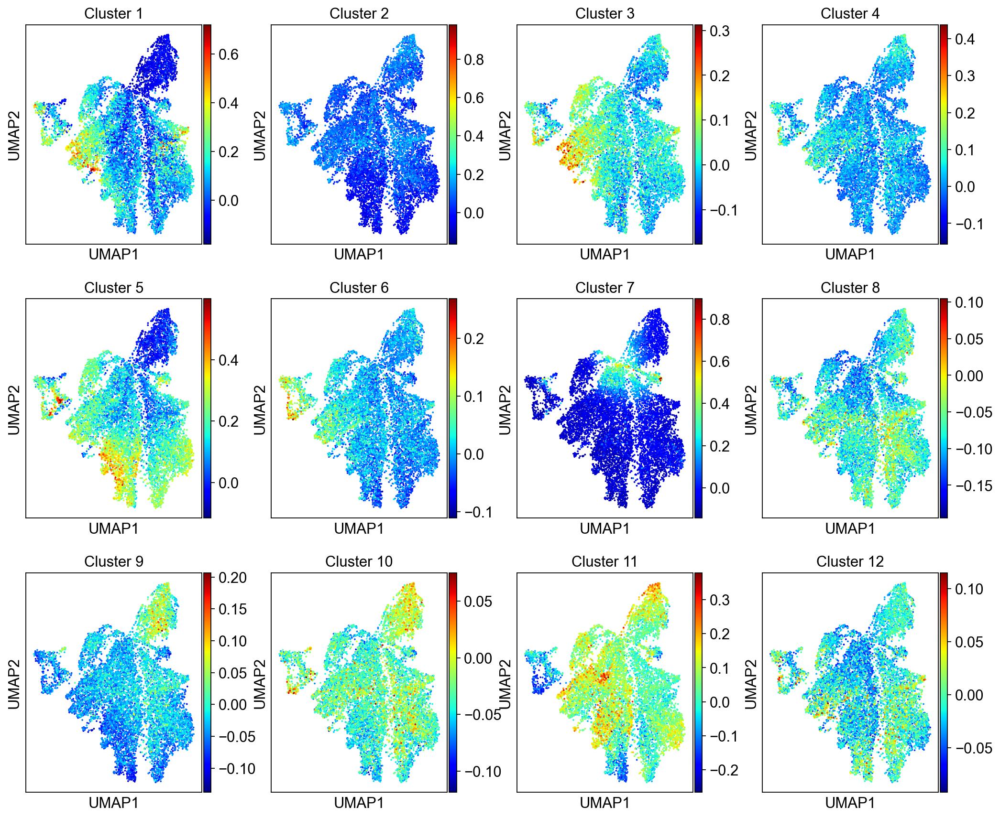

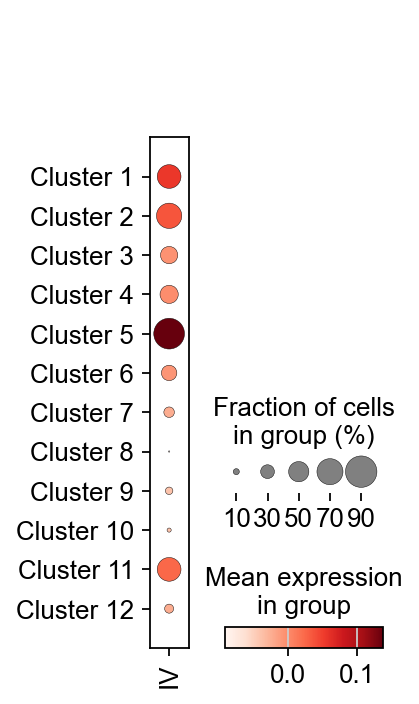

In [98]:
(clusters, clusterkeys, HPCS) = resetClusters('cell2020')
scoreAndPlot(adata, numgenes=100)

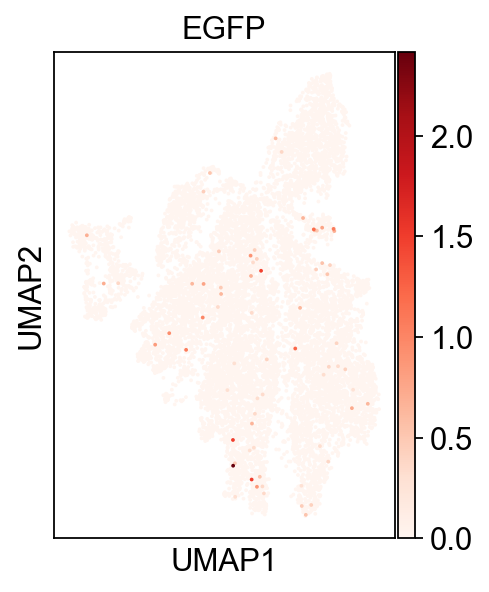

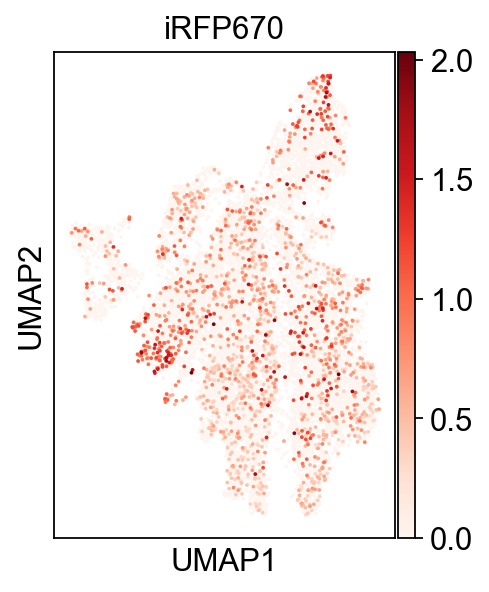

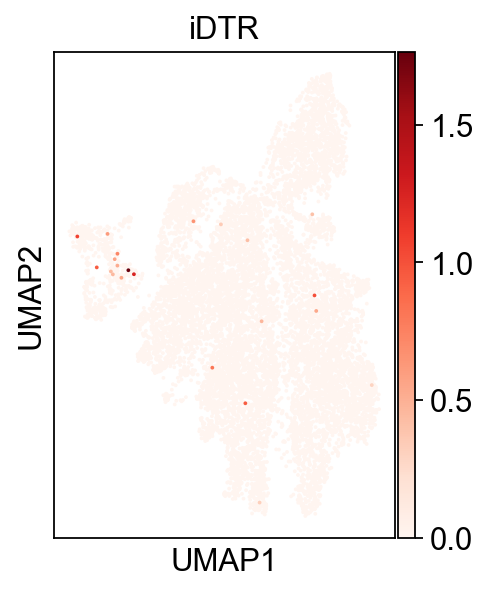

In [99]:
sc.pl.umap(adata, color=['EGFP'], cmap='Reds')
sc.pl.umap(adata, color=['iRFP670'], cmap='Reds')
#sc.pl.umap(adata, color=['mScarlet'], cmap='Reds')
sc.pl.umap(adata, color=['iDTR'], cmap='Reds')

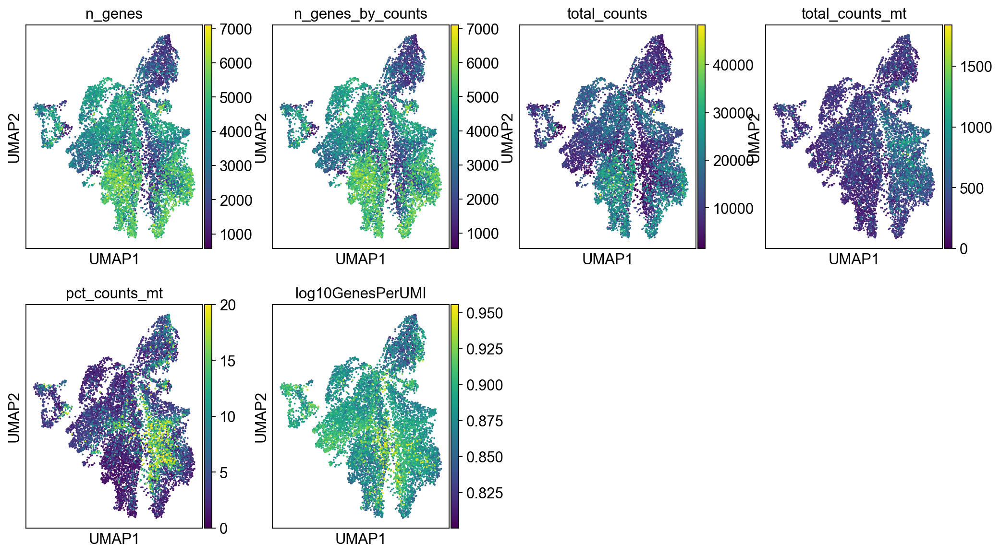

In [100]:
sc.pl.umap(adata, color=['n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt',
       'pct_counts_mt', 'log10GenesPerUMI'])

In [101]:
adata.obs.Classification.value_counts(sort=False)

Classification
IV    10411
Name: count, dtype: int64

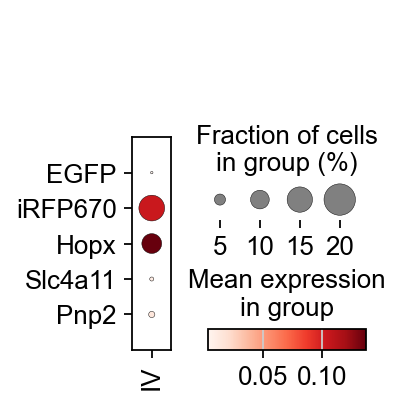

In [102]:
sc.pl.dotplot(adata, ['EGFP','iRFP670','Hopx','Slc4a11','Pnp2'],'Classification',swap_axes=True)

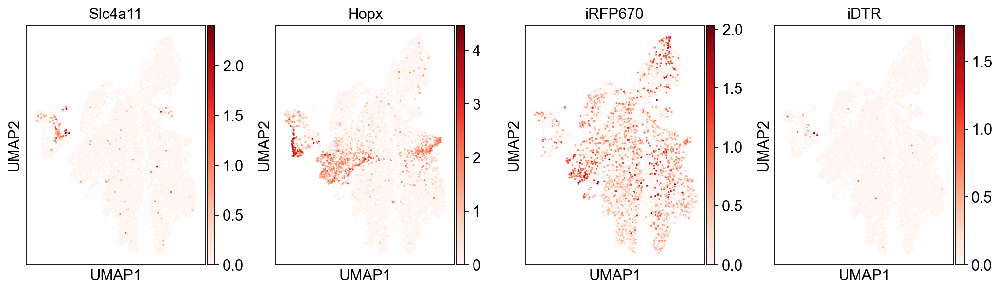

In [103]:
sc.pl.umap(adata, color=['Slc4a11','Hopx','iRFP670','iDTR'],cmap='Reds')

## Clustering the neighborhood graph

running Leiden clustering
    finished: found 9 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


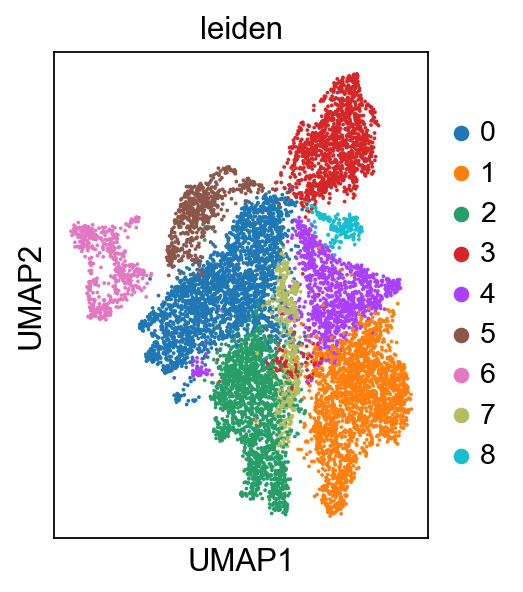

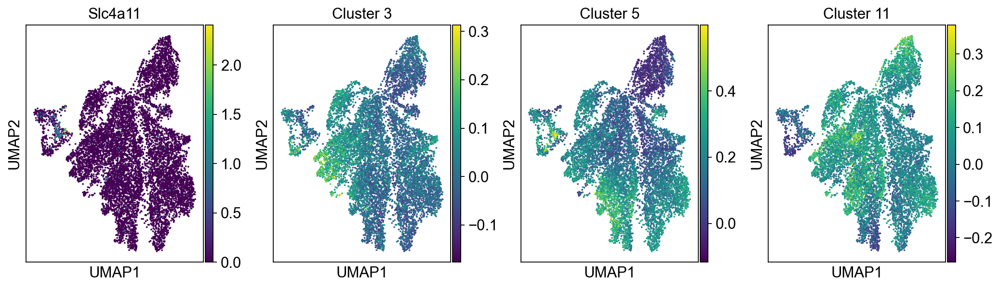

In [104]:
sc.tl.leiden(adata, resolution=.3)
sc.pl.umap(adata, color=['leiden'])
sc.pl.umap(adata, color=['Slc4a11','Cluster 3','Cluster 5','Cluster 11'])

In [105]:
adata.obs[['Classification']].value_counts(sort=False)

Classification
IV                10411
Name: count, dtype: int64

## Logistic Regression

In [106]:
from sklearn.linear_model import LogisticRegression
from joblib import dump, load
names = load('./genes.joblib')

In [107]:
adata_log = adata[:,adata.var.index.isin(names)]

In [108]:
adata_names = [x for x in adata_log.var.index]

In [109]:
goi = [x for x in adata_log.var.index]

## Load SmartSeq h5ad file

In [110]:
smartseq = anndata.read('./smartseq.h5ad')

/Users/chanj2/opt/miniconda3/envs/scbackup2/lib/python3.11/site-packages/anndata/__init__.py:42: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


## Logistic Regression against Cancer Cell 2020 Clusters intersected with 10x data

In [111]:
from sklearn.model_selection import train_test_split

names_adata = smartseq[:,smartseq.var.index.isin(goi)]

X_train, X_test, y_train, y_test = train_test_split(names_adata.X, smartseq.obs['clusterK12'], test_size=0.25, random_state=250)

In [112]:
names = [x for x in names_adata.var.index]

In [113]:
# import the class
from sklearn.linear_model import LogisticRegression

# instantiate the model (using the default parameters)
#logreg = LogisticRegression(random_state=250)
#logreg = LogisticRegression(random_state=250,multi_class='multinomial',solver='saga')
logreg = LogisticRegression(random_state=250,multi_class='multinomial', solver='lbfgs')

# fit the model with data
logreg.fit(X_train, y_train)

y_pred = logreg.predict(X_test)
y_score = logreg.predict_proba(X_test)


/Users/chanj2/opt/miniconda3/envs/scbackup2/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1264: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(


In [114]:
# import the metrics class
from sklearn import metrics

cnf_matrix = metrics.confusion_matrix(y_test, y_pred)
cnf_matrix

array([[137,   6,   3,   0,   2,   1,   2,   0,   1,   0,   0,   0],
       [  5,  70,   0,   2,   0,   0,   0,   0,   1,   1,   0,   1],
       [  0,   0,  40,   0,   3,   0,   0,   3,   0,   1,   0,   0],
       [  1,   3,   1,  58,   0,   0,   0,  11,   3,   0,   0,   0],
       [  0,   0,   4,   0, 176,   2,   0,   3,   1,   2,   0,   1],
       [  0,   0,   0,   0,   0,  34,   0,   0,   0,   0,   0,   0],
       [  0,   0,   0,   0,   0,   0,  13,   0,   2,   0,   0,   0],
       [  0,   0,   0,   1,   1,   0,   0, 133,   4,   4,   0,   1],
       [  0,   0,   0,   0,   1,   0,   0,   3,  37,   1,   0,   0],
       [  0,   0,   1,   0,   1,   0,   0,   3,   0,  58,   0,   0],
       [  0,   0,   0,   0,   0,   0,   0,   0,   1,   0,  13,   0],
       [  0,   0,   0,   0,   1,   0,   0,   0,   1,   0,   0,  41]])

Text(0.5, 295.64444444444445, 'Predicted label')

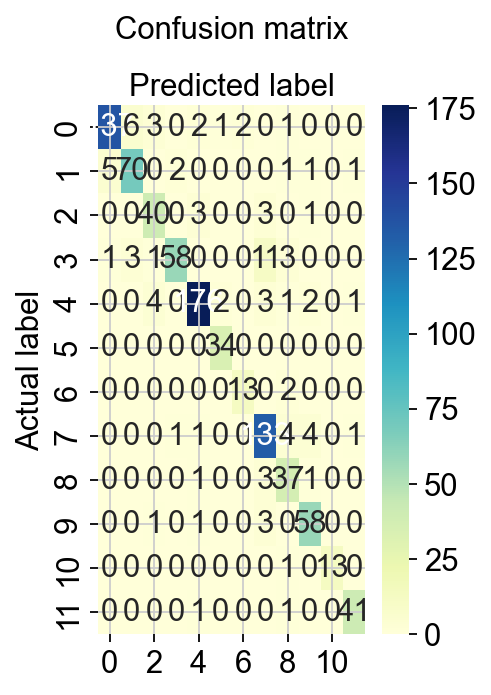

In [115]:
# import required modules
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

class_names=[0,1] # name  of classes
fig, ax = plt.subplots()
tick_marks = np.arange(len(class_names))
plt.xticks(tick_marks, class_names)
plt.yticks(tick_marks, class_names)
# create heatmap
sns.heatmap(pd.DataFrame(cnf_matrix), annot=True, cmap="YlGnBu" ,fmt='g')
ax.xaxis.set_label_position("top")
plt.tight_layout()
plt.title('Confusion matrix', y=1.1)
plt.ylabel('Actual label')
plt.xlabel('Predicted label')

#Text(0.5,257.44,'Predicted label');

In [116]:
from sklearn.metrics import classification_report
target_names = ['1', '2', '3','4','5','6','7','8','9','10','11','12']
print(classification_report(y_test, y_pred, target_names=target_names))

              precision    recall  f1-score   support

           1       0.96      0.90      0.93       152
           2       0.89      0.88      0.88        80
           3       0.82      0.85      0.83        47
           4       0.95      0.75      0.84        77
           5       0.95      0.93      0.94       189
           6       0.92      1.00      0.96        34
           7       0.87      0.87      0.87        15
           8       0.85      0.92      0.89       144
           9       0.73      0.88      0.80        42
          10       0.87      0.92      0.89        63
          11       1.00      0.93      0.96        14
          12       0.93      0.95      0.94        43

    accuracy                           0.90       900
   macro avg       0.89      0.90      0.89       900
weighted avg       0.90      0.90      0.90       900



In [117]:
from sklearn.preprocessing import LabelBinarizer

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)
y_onehot_test.shape  # (n_samples, n_classes)

(900, 12)

In [118]:
label_binarizer.classes_

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12])

In [119]:
class_of_interest = 5
class_id = np.flatnonzero(label_binarizer.classes_ == class_of_interest)[0]
class_id

np.int64(4)

/Users/chanj2/opt/miniconda3/envs/scbackup2/lib/python3.11/site-packages/sklearn/utils/_plotting.py:175: FutureWarning: `**kwargs` is deprecated and will be removed in 1.9. Pass all matplotlib arguments to `curve_kwargs` as a dictionary instead.
  warnings.warn(


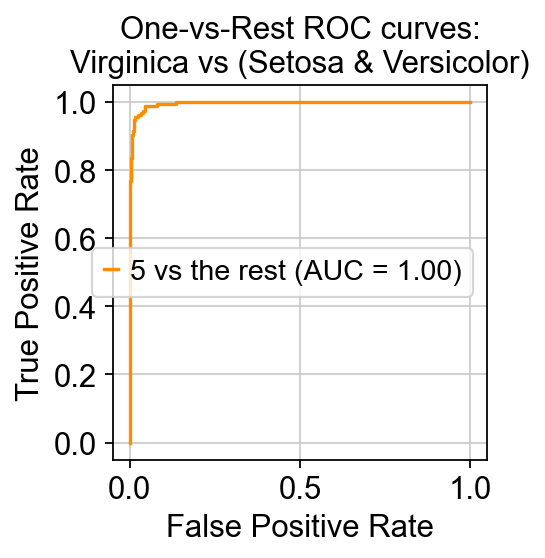

In [120]:
import matplotlib.pyplot as plt

from sklearn.metrics import RocCurveDisplay

RocCurveDisplay.from_predictions(
    y_onehot_test[:, class_id],
    y_score[:, class_id],
    name=f"{class_of_interest} vs the rest",
    color="darkorange",
    #plot_chance_level=True,
)
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("One-vs-Rest ROC curves:\nVirginica vs (Setosa & Versicolor)")
plt.legend()
plt.show()

In [121]:
y_pred = logreg.predict(smartseq[:,names].X)
y_proba = logreg.predict_proba(smartseq[:,names].X)

In [122]:
smartseq.obs['clusterK12_intersecting'] = [x for x in y_pred]
smartseq.obs['clusterK12_intersecting'] = smartseq.obs['clusterK12_intersecting'].astype('category')

In [123]:
#results_binary = y_pred
#probs_binary = y_proba

results_binary = logreg.predict(X_test)
probs_binary = logreg.predict_proba(X_test)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
results_df_binary['actual'] = list(y_test)
for x in range(0,12):
    results_df_binary["probability_%d" % (x+1)] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[["probability_%d" % (x+1) for x in range(0,12)]].max(axis=1)
results_df_binary['correct'] = (results_df_binary['predicted'] == results_df_binary['actual']).astype(int)
results_df_binary

,predicted,actual,probability_1,probability_2,probability_3,probability_4,probability_5,probability_6,probability_7,probability_8,probability_9,probability_10,probability_11,probability_12,highest_prob,correct
0,3,3,6.458287e-09,2.320726e-05,5.153128e-01,5.782556e-02,6.068438e-07,8.501732e-05,1.848768e-04,4.211752e-01,3.126356e-05,1.711236e-05,5.321397e-05,5.291211e-03,0.515313,1
1,1,1,9.999997e-01,7.532618e-08,4.798224e-11,1.054336e-09,3.350262e-09,6.364367e-08,1.231445e-07,5.498776e-13,5.215601e-12,2.288164e-12,6.656911e-09,1.354350e-10,1.000000,1
2,8,8,5.832289e-06,1.335127e-04,3.528710e-04,7.053451e-04,1.166487e-04,1.195245e-04,4.359177e-04,9.679103e-01,2.271981e-02,6.994372e-03,4.677126e-04,3.819068e-05,0.967910,1
3,10,10,4.737894e-04,9.927198e-03,4.124724e-04,2.968344e-05,3.081216e-01,3.680514e-03,3.160805e-04,8.626562e-05,4.041246e-04,6.758503e-01,2.433182e-04,4.546436e-04,0.675850,1
4,8,8,9.861238e-07,6.100476e-06,1.247953e-06,2.030906e-04,9.266351e-06,3.916188e-05,1.959957e-04,9.206327e-01,7.866435e-02,5.164154e-05,2.629618e-05,1.691656e-04,0.920633,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
895,5,5,3.483623e-03,6.106000e-07,3.006070e-05,1.706582e-04,9.301744e-01,5.286069e-02,4.238306e-04,1.536353e-03,2.145114e-03,8.854601e-03,2.909167e-04,2.911923e-05,0.930174,1
896,5,5,1.039497e-07,6.548882e-04,7.938067e-06,1.767105e-04,9.991113e-01,6.492880e-06,5.481620e-06,2.496585e-11,4.107446e-07,1.481017e-07,3.457887e-05,1.935126e-06,0.999111,1
897,8,8,3.027424e-07,3.850196e-06,5.498125e-06,1.311835e-03,1.610664e-09,1.508893e-06,2.415219e-05,9.800080e-01,1.851811e-02,1.164434e-04,5.761984e-06,4.568688e-06,0.980008,1
898,5,5,1.450638e-10,1.384181e-07,2.022650e-05,5.324635e-10,9.999763e-01,4.489521e-08,7.907039e-07,4.075882e-07,5.640347e-08,4.212754e-08,1.706388e-06,2.756891e-07,0.999976,1


In [124]:
results_df_binary['bin'] = pd.qcut(results_df_binary['highest_prob'], q=7)
idx = pd.IntervalIndex(results_df_binary['bin'])
results_df_binary['low'] = idx.left
results_df_binary['high'] = idx.right
results_df_binary['prob range'] = results_df_binary['low'].round(2).astype(str) + "-" + results_df_binary['high'].round(2).astype(str)
df_bins_grouped = results_df_binary[['low','high','correct','prob range']].groupby('prob range').mean().reset_index()
df_bins_grouped

,prob range,low,high,correct
0,0.35-0.82,0.351450,0.818890,0.596899
1,0.82-0.97,0.818890,0.973190,0.859375
2,0.97-1.0,0.973190,0.995700,0.883721
3,1.0-1.0,0.998726,0.999798,0.990272


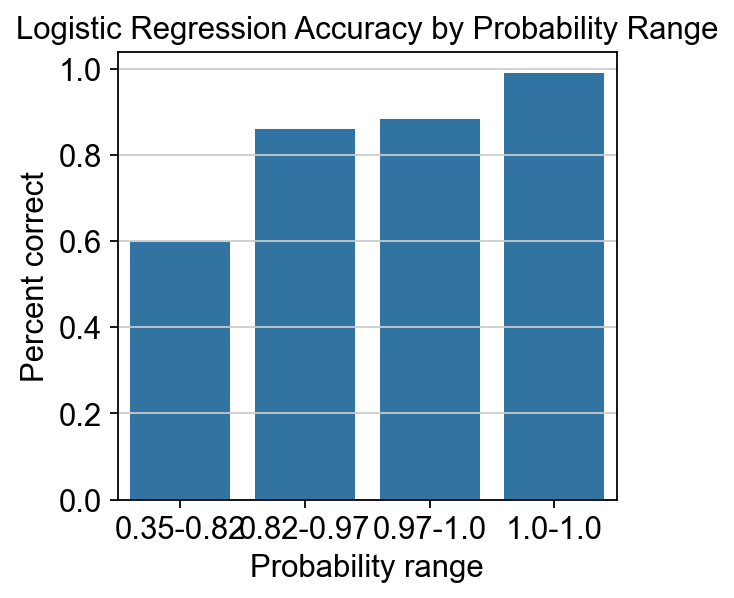

In [125]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize=(4,4))
plt.subplots_adjust(top=0.85)
#plt.figure(figsize=(11,9))
#plt.subplots_adjust(top=0.85)

ax = sns.barplot(x='prob range', y='correct', data=df_bins_grouped)
plt.title("Logistic Regression Accuracy by Probability Range")
plt.ylabel('Percent correct')
plt.xlabel('Probability range')
plt.show()

In [126]:
#reset size
from matplotlib import rcParams
FIGSIZE=(4,4)
rcParams['figure.figsize']=FIGSIZE

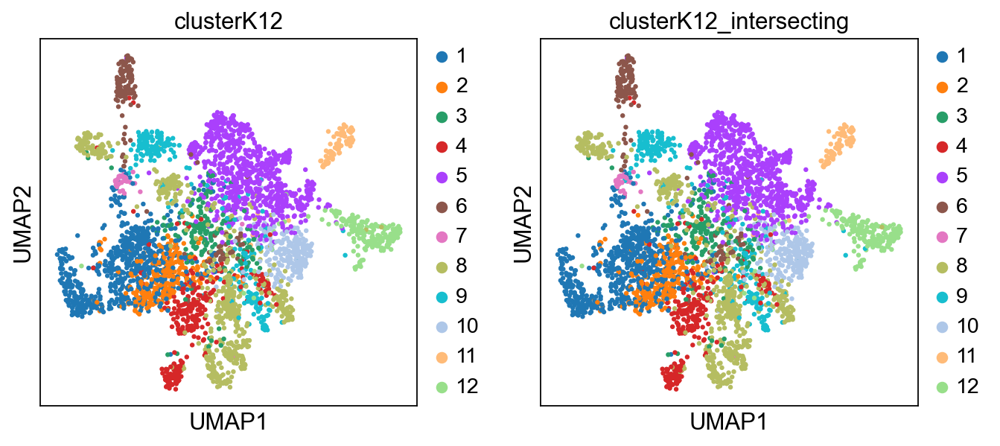

In [127]:
sc.pl.umap(smartseq, color=['clusterK12','clusterK12_intersecting'])

In [128]:
dict = {1: "01", 2: "02", 3: "03", 4: "04", 5: "05", 6: "06", 7: "07", 8: "08", 9: "09", 10: "10", 11: "11", 12: "12"}

In [129]:
from sklearn.metrics import accuracy_score
accuracy_score(smartseq.obs.replace({"clusterK12": dict})['clusterK12'], smartseq.obs['clusterK12_intersecting'])

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_49533/3184290090.py:2: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  accuracy_score(smartseq.obs.replace({"clusterK12": dict})['clusterK12'], smartseq.obs['clusterK12_intersecting'])


0.0

In [130]:
results_binary = logreg.predict(smartseq[:,names].X)
probs_binary = logreg.predict_proba(smartseq[:,names].X)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
for x in range(0,12):
    results_df_binary[x+1] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[[x+1 for x in range(0,12)]].max(axis=1)
results_df_binary

,predicted,1,2,3,4,5,6,7,8,9,10,11,12,highest_prob
0,11,1.407574e-09,2.691268e-07,4.309023e-08,1.034805e-10,1.182829e-09,4.550820e-11,2.268502e-09,6.922372e-16,1.093611e-09,4.217916e-12,9.999997e-01,2.309445e-09,1.000000
1,12,5.367296e-10,7.273321e-10,4.144209e-10,1.177681e-08,3.628172e-13,4.891526e-07,6.895417e-09,8.293567e-10,2.743735e-07,9.461534e-08,2.602182e-09,9.999991e-01,0.999999
2,5,7.103674e-04,3.021424e-08,1.377965e-03,8.378051e-08,9.978209e-01,1.919064e-05,2.258135e-05,9.358038e-08,1.043985e-07,1.912050e-05,9.685781e-06,1.985553e-05,0.997821
3,10,3.799897e-05,2.865605e-05,7.298983e-06,3.010387e-03,1.563408e-07,4.163241e-05,6.789060e-06,3.640922e-04,1.311257e-05,9.964510e-01,4.276154e-06,3.461374e-05,0.996451
4,1,9.999997e-01,3.151661e-10,1.128959e-07,9.451583e-08,2.428351e-09,7.805480e-09,5.656719e-09,6.579431e-11,1.812056e-13,8.088732e-10,2.617812e-08,1.125328e-09,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3595,8,6.587994e-08,2.158444e-05,2.469438e-07,1.246122e-06,6.133296e-09,3.792509e-08,6.087432e-07,9.997024e-01,2.733921e-04,2.544387e-07,1.100607e-07,1.188818e-08,0.999702
3596,9,7.776374e-11,4.276061e-08,1.562280e-08,1.010796e-07,3.841649e-09,7.534119e-09,7.450600e-07,5.193651e-03,9.948052e-01,2.532791e-08,1.702637e-07,1.923312e-08,0.994805
3597,8,1.277505e-06,1.645679e-05,4.194667e-07,8.292783e-05,4.971269e-09,1.251671e-07,4.793768e-06,9.993911e-01,4.996434e-04,1.338842e-06,1.201858e-06,7.554103e-07,0.999391
3598,8,3.907125e-08,8.575339e-06,1.298450e-06,1.742272e-06,3.101983e-05,7.409718e-08,1.843225e-06,9.999414e-01,1.112086e-05,2.023524e-06,6.319749e-07,2.266059e-07,0.999941


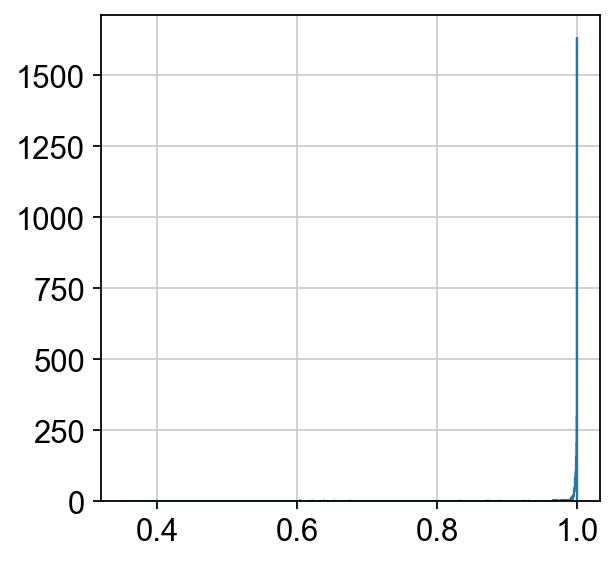

In [131]:
_ = plt.hist(results_df_binary['highest_prob'], bins='auto', histtype='step')

## End LogisticRegression

In [132]:
adata_ordered_genes = [adata_names.index(x) for x in names]

In [133]:
adata_log_ordered = adata_log[:,adata_ordered_genes]

In [134]:
y_pred = logreg.predict(adata_log_ordered.X)

In [135]:
adata_log_ordered.obs['clusterK12'] = [x for x in y_pred]
adata_log_ordered.obs['clusterK12'] = adata_log_ordered.obs['clusterK12'].astype('category')

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_49533/3908199522.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_log_ordered.obs['clusterK12'] = [x for x in y_pred]


In [136]:
#reset size
from matplotlib import rcParams
FIGSIZE=(4,4)
rcParams['figure.figsize']=FIGSIZE

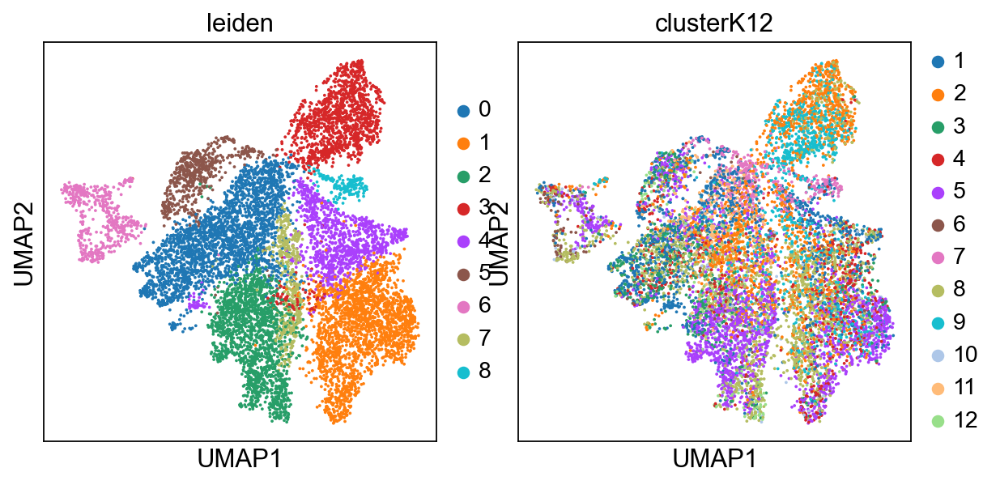

In [137]:
sc.pl.umap(adata_log_ordered,color=['leiden','clusterK12'], wspace=0.1)

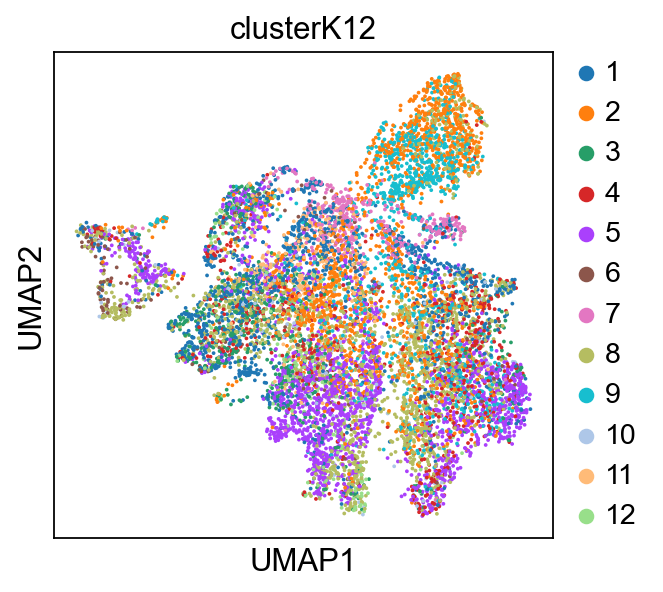

In [138]:
sc.pl.umap(adata_log_ordered,color=['clusterK12'])

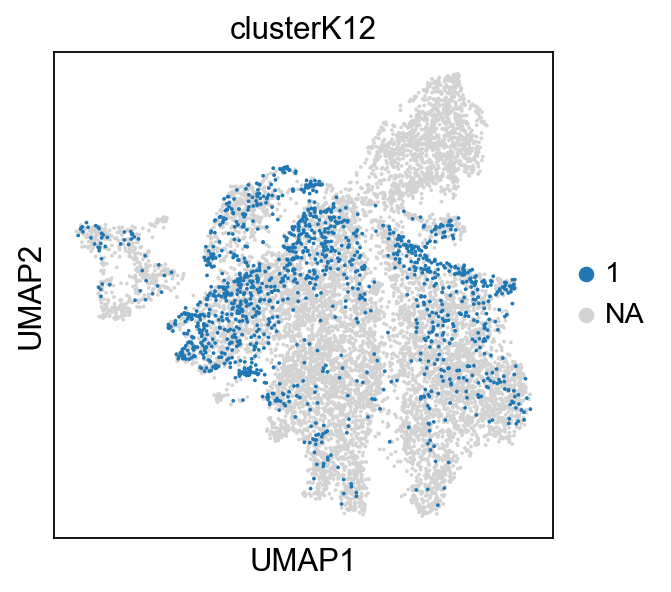

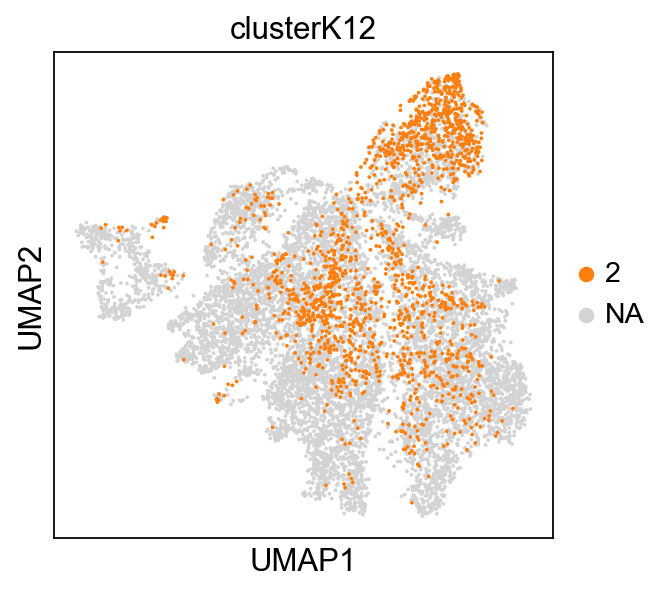

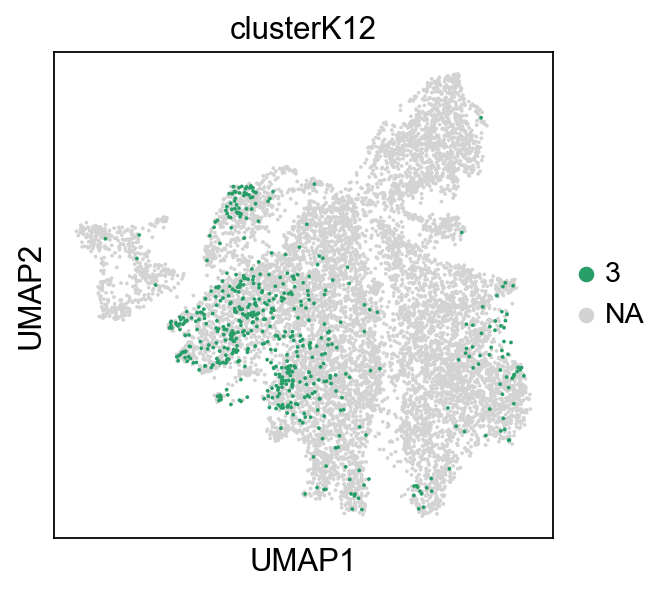

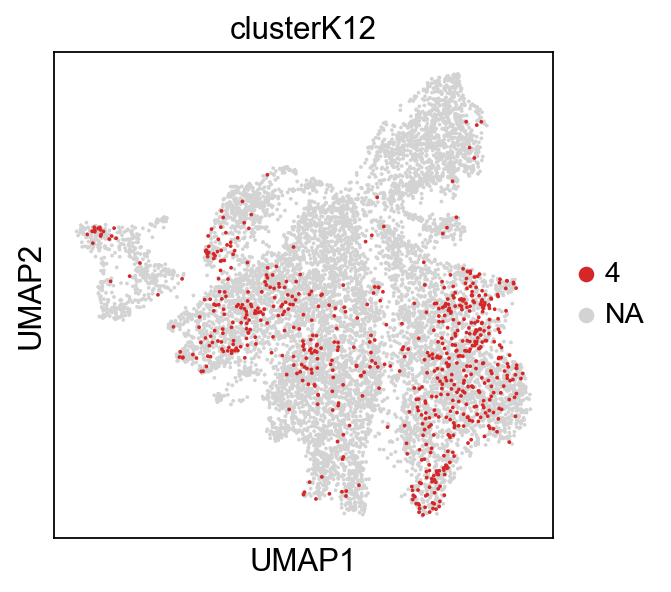

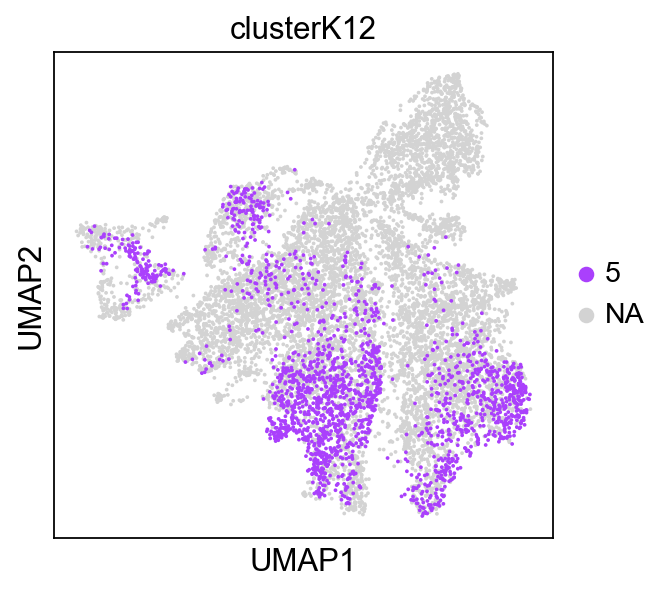

...

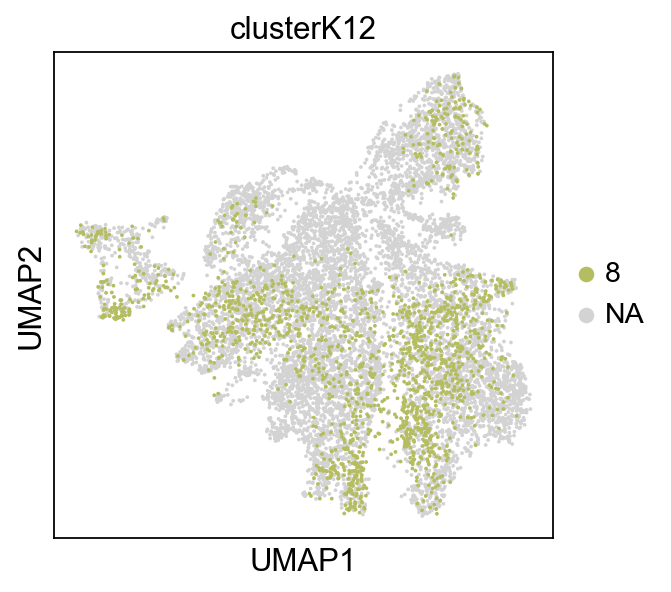

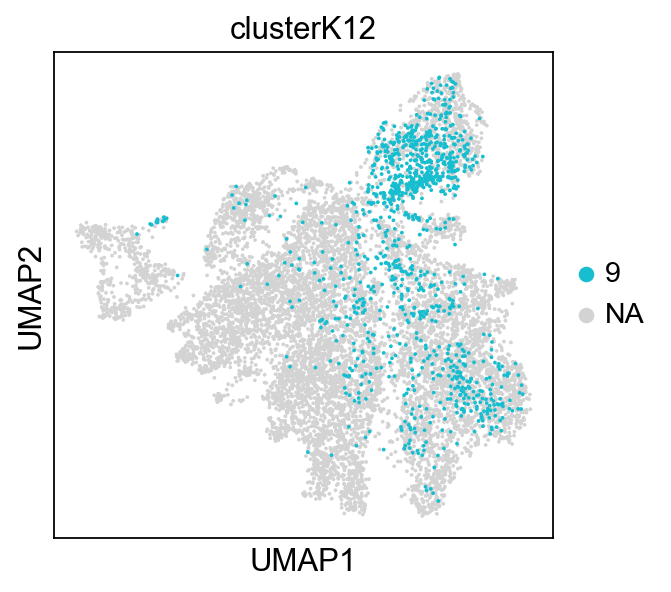

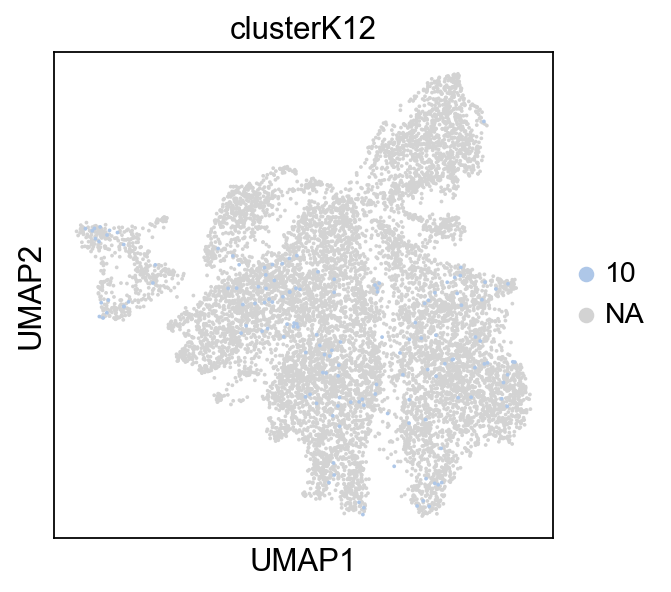

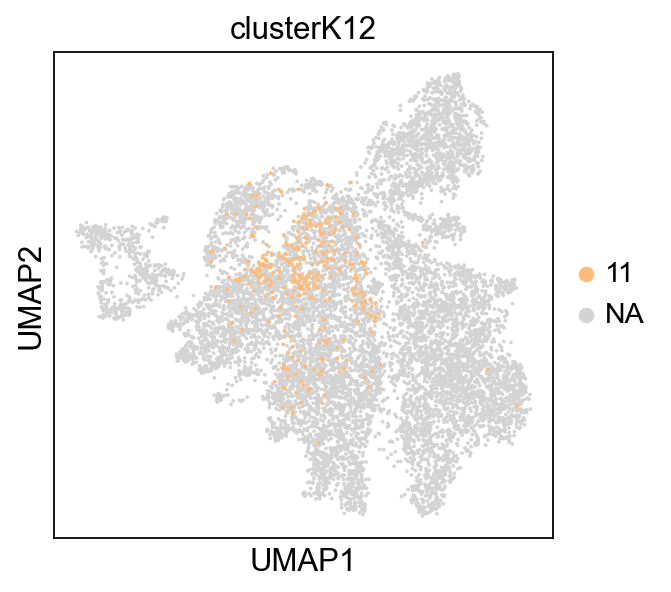

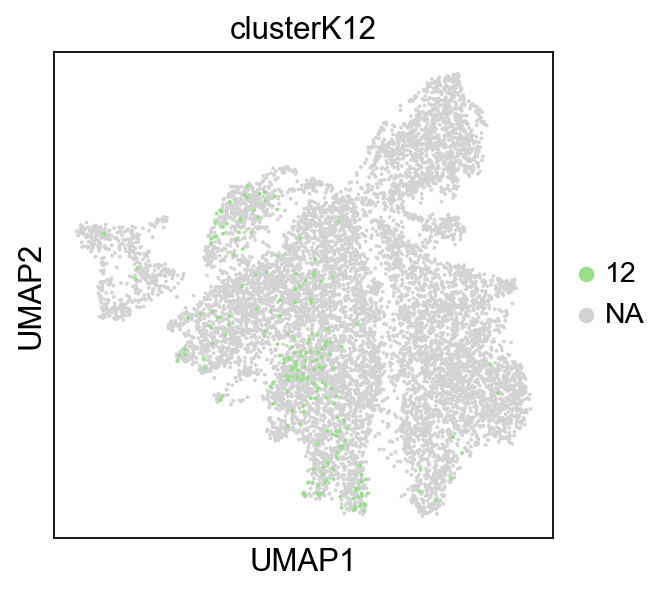

In [139]:
for x in adata_log_ordered.obs.clusterK12.cat.categories:
    sc.pl.umap(adata_log_ordered,color=['clusterK12'], groups=[x])

In [140]:
# bug fix
adata_log_ordered.uns['log1p']['base'] = None

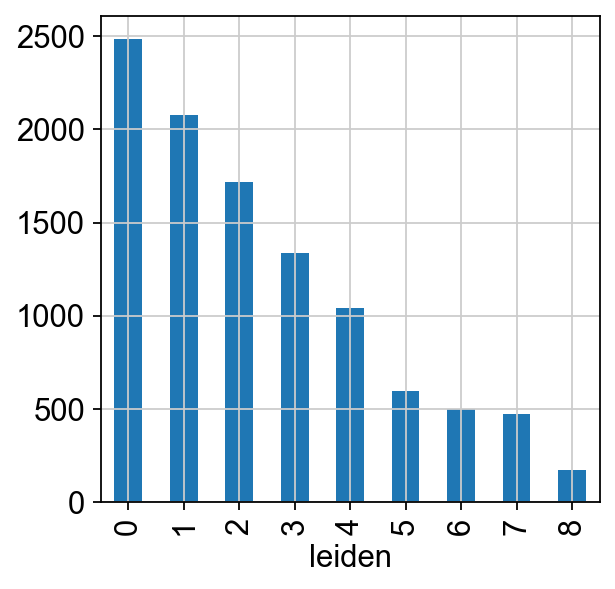

In [141]:
 cell_proportion_df = adata_log_ordered.obs.leiden.value_counts().T.plot(kind='bar', stacked=True, legend=False)

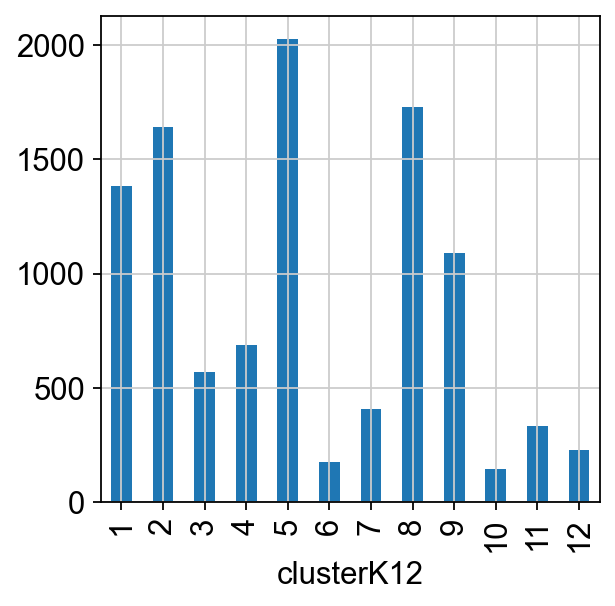

In [142]:
 cell_proportion_df = adata_log_ordered.obs.clusterK12.value_counts(sort=False).T.plot(kind='bar', stacked=True, legend=False)

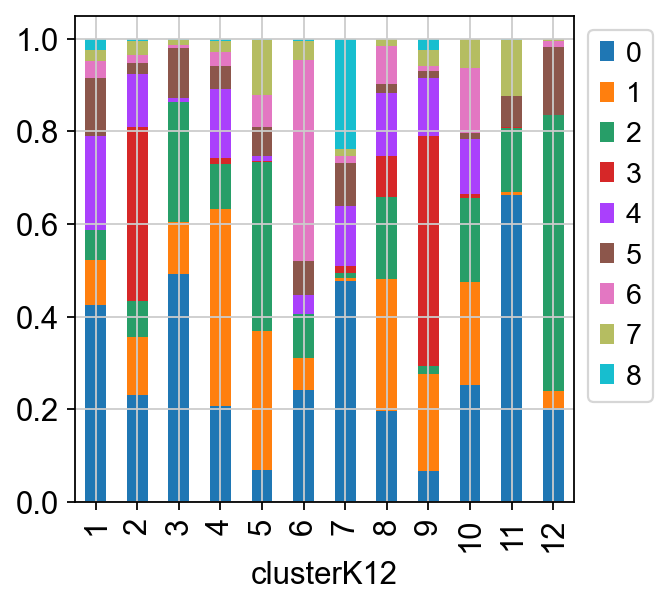

In [143]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [144]:
results_binary = logreg.predict(adata_log_ordered.X)
probs_binary = logreg.predict_proba(adata_log_ordered.X)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
for x in range(0,12):
    results_df_binary[x+1] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[[x+1 for x in range(0,12)]].max(axis=1)
results_df_binary

,predicted,1,2,3,4,5,6,7,8,9,10,11,12,highest_prob
0,5,0.011433,0.010239,0.014356,0.046292,0.845810,0.006273,0.006940,0.000002,0.000056,0.004840,0.031375,0.022384,0.845810
1,5,0.037750,0.000746,0.264038,0.053612,0.327044,0.008762,0.005652,0.006126,0.000230,0.012533,0.110016,0.173491,0.327044
2,5,0.073399,0.000006,0.006947,0.003258,0.850097,0.007062,0.002044,0.000790,0.000056,0.002425,0.006305,0.047612,0.850097
3,1,0.762399,0.000002,0.049060,0.000260,0.000109,0.000578,0.000848,0.163356,0.000130,0.008652,0.011778,0.002829,0.762399
4,9,0.032862,0.003313,0.012053,0.161877,0.013235,0.008924,0.016446,0.260842,0.287969,0.178458,0.013827,0.010193,0.287969
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10406,5,0.013247,0.056507,0.201689,0.048295,0.469928,0.019631,0.015460,0.003306,0.000958,0.007126,0.050758,0.113094,0.469928
10407,6,0.004795,0.002477,0.000167,0.002995,0.000785,0.939953,0.000229,0.000556,0.001582,0.024139,0.000082,0.022241,0.939953
10408,11,0.026081,0.099143,0.143413,0.035050,0.069466,0.039055,0.069478,0.090439,0.111004,0.016610,0.294101,0.006161,0.294101
10409,2,0.148057,0.632631,0.000673,0.009172,0.000625,0.002214,0.005879,0.004293,0.191381,0.001534,0.001948,0.001595,0.632631


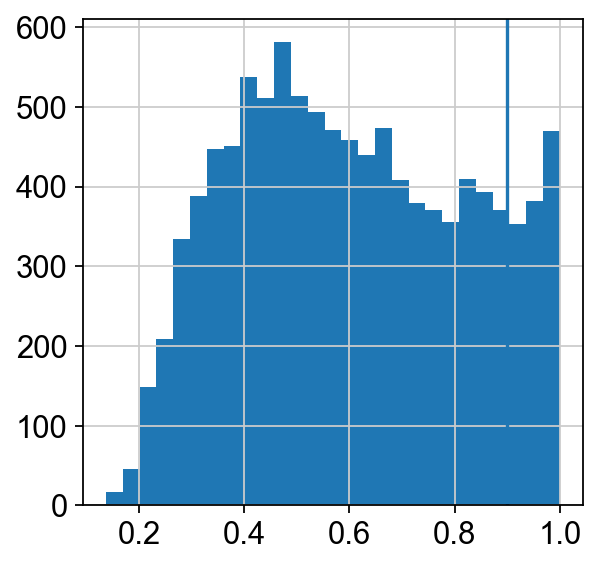

In [145]:
_ = plt.hist(results_df_binary['highest_prob'], bins='auto')
plt.axvline(x=0.9)

In [146]:
results_df_binary['bin'] = pd.qcut(results_df_binary['highest_prob'], q=7)
idx = pd.IntervalIndex(results_df_binary['bin'])
results_df_binary['low'] = idx.left
results_df_binary['high'] = idx.right
results_df_binary['prob range'] = results_df_binary['low'].round(2).astype(str) + "-" + results_df_binary['high'].round(2).astype(str)
df_bins_grouped = results_df_binary[['low','high','prob range']].groupby('prob range').mean().reset_index()
df_bins_grouped

,prob range,low,high
0,0.14-0.35,0.136,0.354
1,0.35-0.45,0.354,0.451
2,0.45-0.54,0.451,0.539
3,0.54-0.64,0.539,0.641
4,0.64-0.76,0.641,0.755
5,0.76-0.88,0.755,0.880
6,0.88-1.0,0.880,1.000


In [147]:
cutoff = 0.8
adata_log_ordered.obs['clusterK12_stringent'] = 'other'
adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % y for y in results_df_binary[[x+1 for x in range(0,12)]].idxmax(axis=1)[np.array(results_df_binary['highest_prob'] >= cutoff)].to_numpy()]

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_49533/4020989001.py:3: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % 

In [148]:
adata_log_ordered.obs['clusterK12_stringent']

AAACCATTCCTTCCTC-1       05
AAACCATTCTGGTAGC-1    other
AAACCCGCAACATGGT-1       05
AAACCCGCAATCGCTC-1    other
AAACCCGCACCAGGGT-1    other
                      ...  
TGTGTTGAGCGGATGA-1    other
TGTGTTGAGCTGGACT-1       06
TGTGTTGAGCTTACCT-1    other
TGTGTTGAGGAGGTGC-1    other
TGTGTTGAGTTAACCG-1    other
Name: clusterK12_stringent, Length: 10411, dtype: object

In [149]:
adata_log_ordered.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

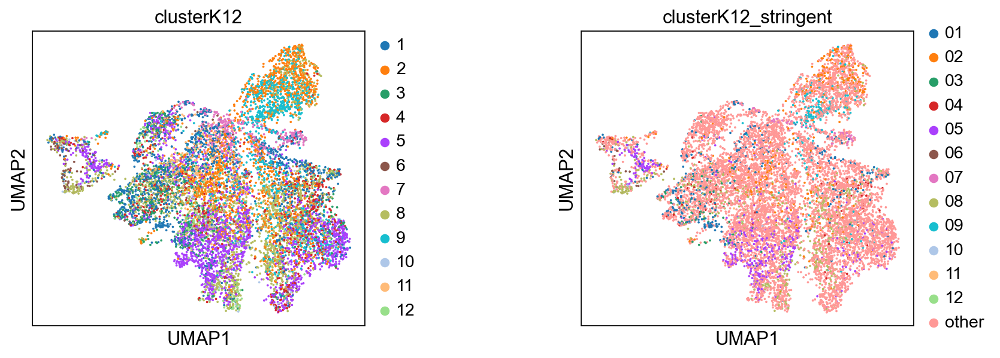

In [150]:
sc.pl.umap(adata_log_ordered, color=['clusterK12', 'clusterK12_stringent'], wspace=0.5)

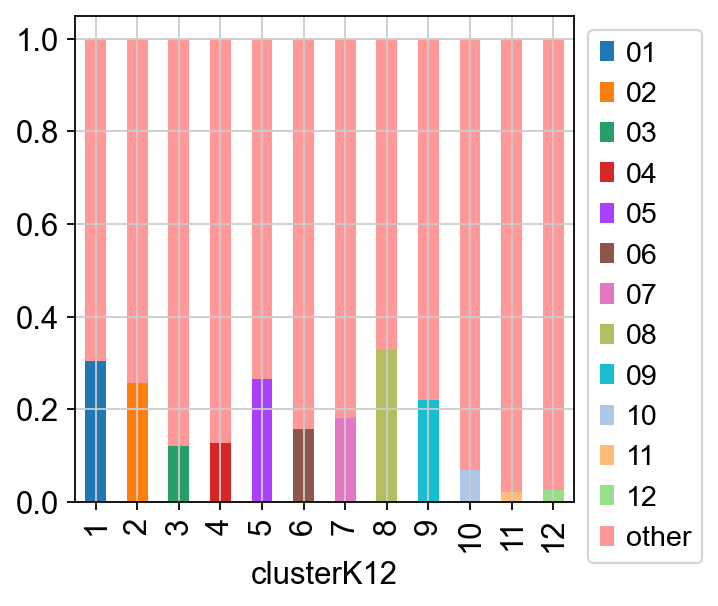

In [151]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['clusterK12_stringent'],adata_log_ordered.obs['clusterK12'],normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

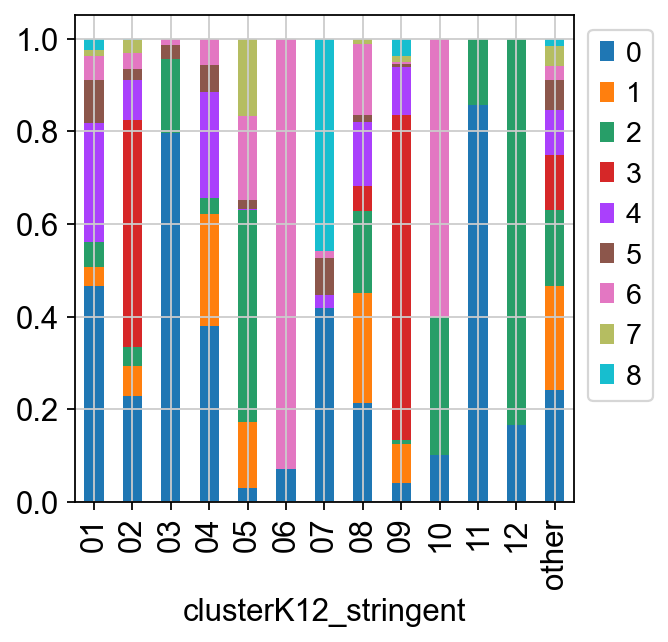

In [152]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

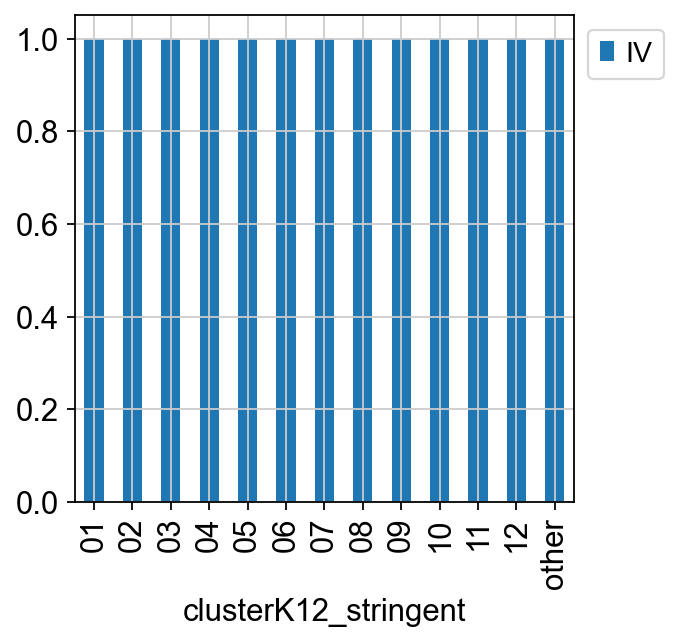

In [153]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['Classification'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

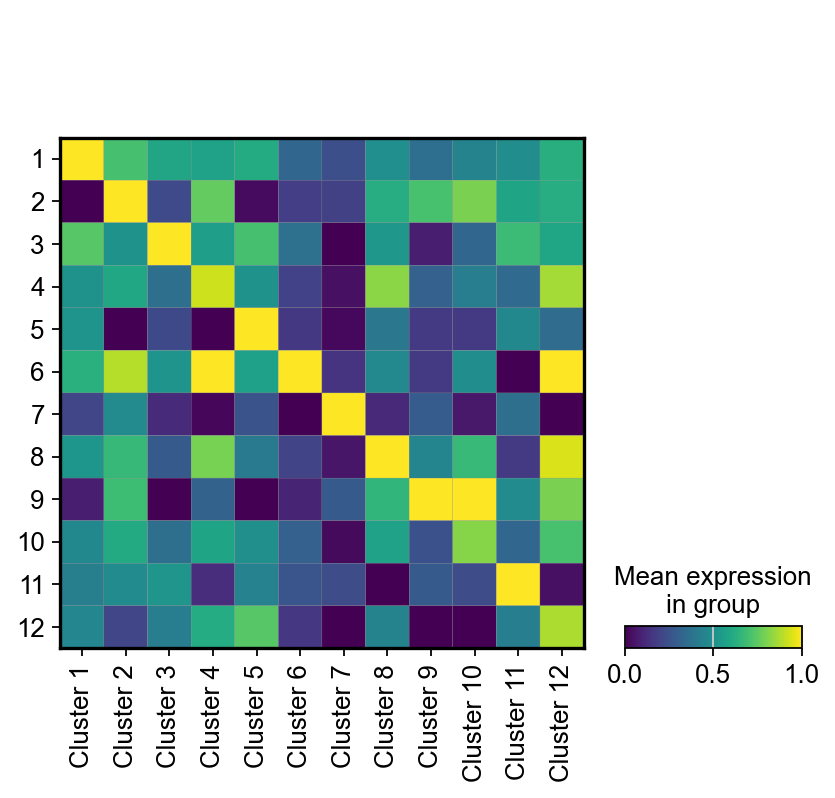

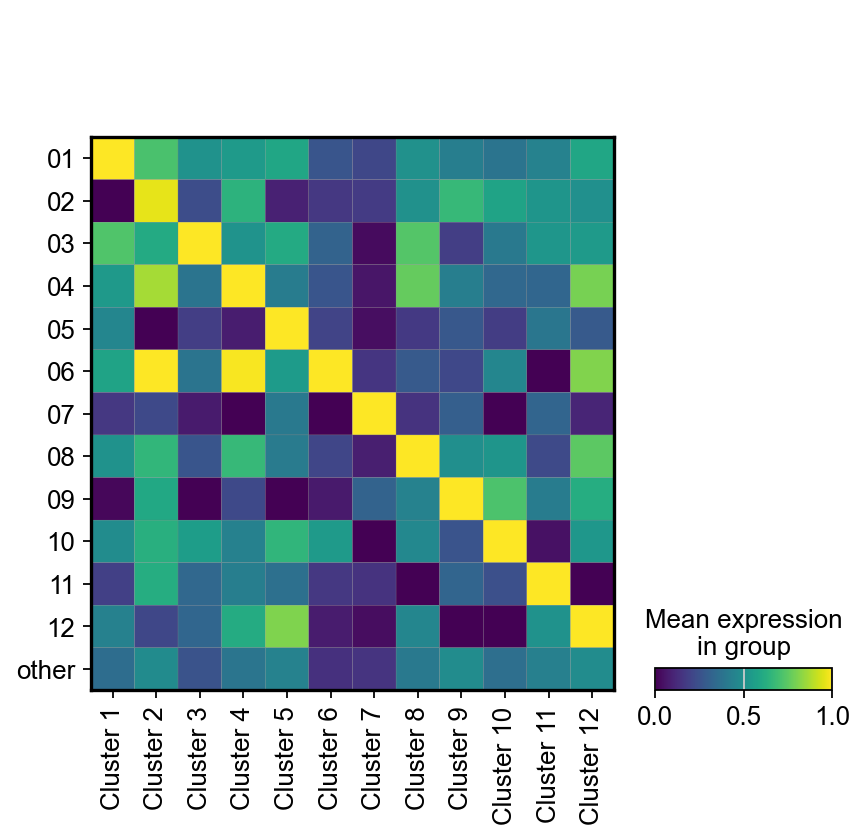

In [154]:
cancerCell = ['Cluster 1', 'Cluster 2','Cluster 3','Cluster 4','Cluster 5','Cluster 6', 'Cluster 7', 
              'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12']
#cell_proportion_df = pd.crosstab(adata_log_ordered.obs['Cluster 1'],adata_log_ordered.obs['clusterK12']).T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))
sc.pl.matrixplot(adata_log_ordered, cancerCell, 'clusterK12', standard_scale='var')
sc.pl.matrixplot(adata_log_ordered, cancerCell, 'clusterK12_stringent', standard_scale='var')

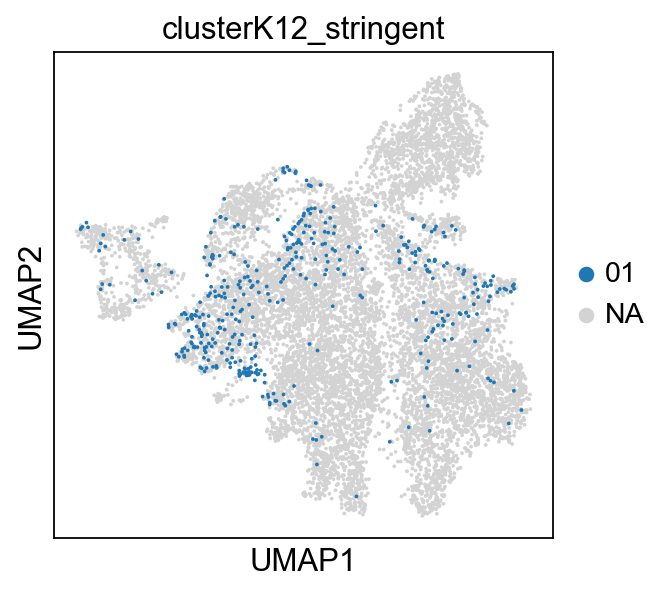

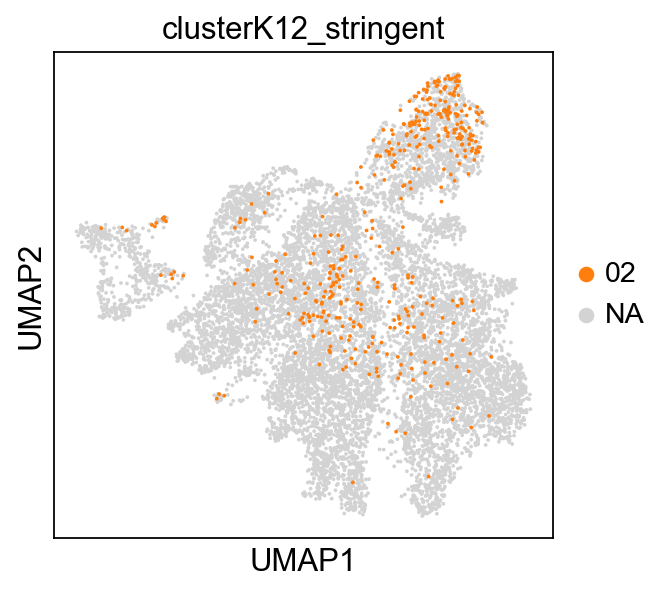

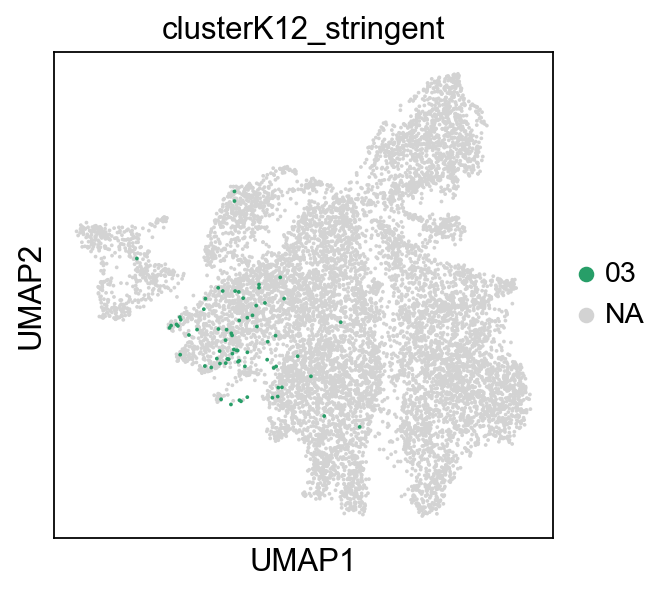

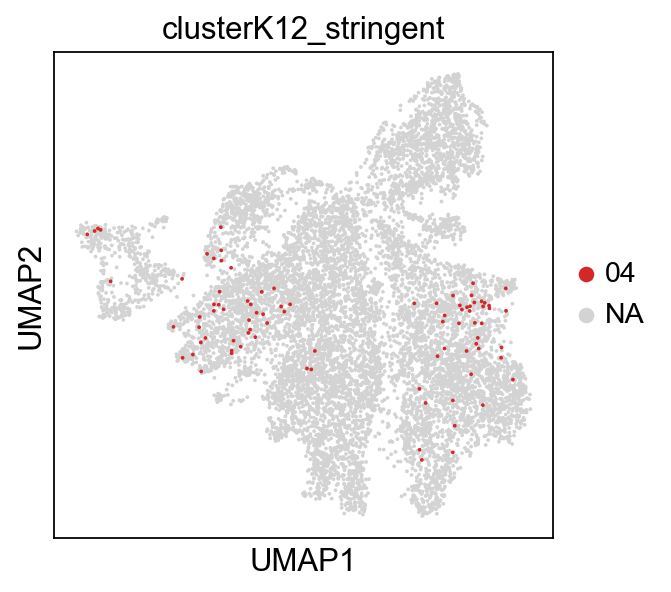

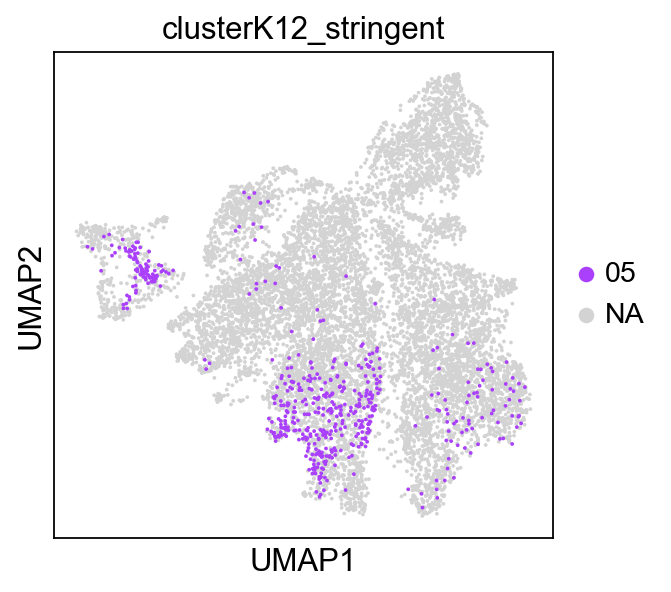

...

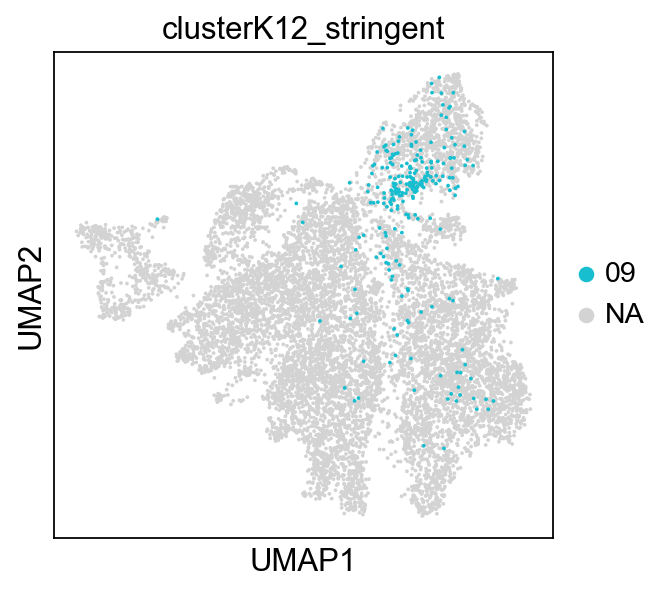

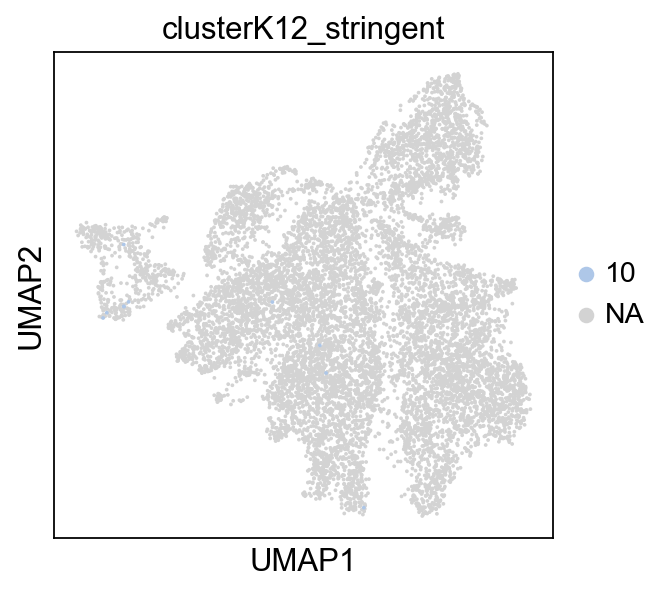

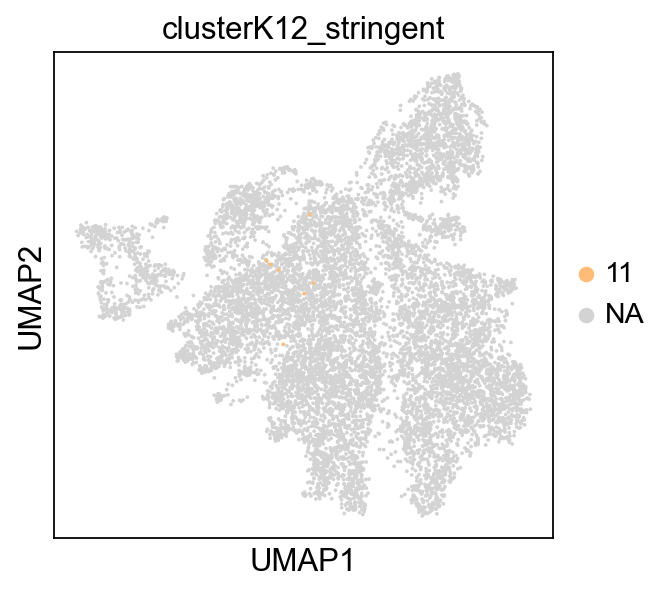

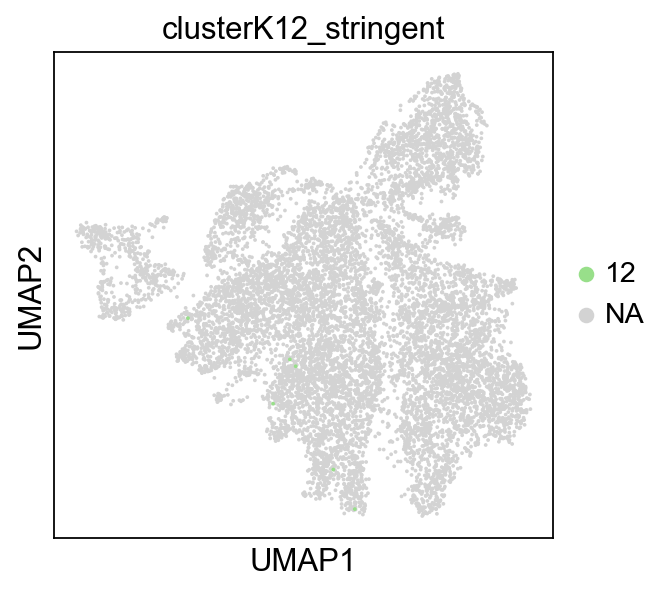

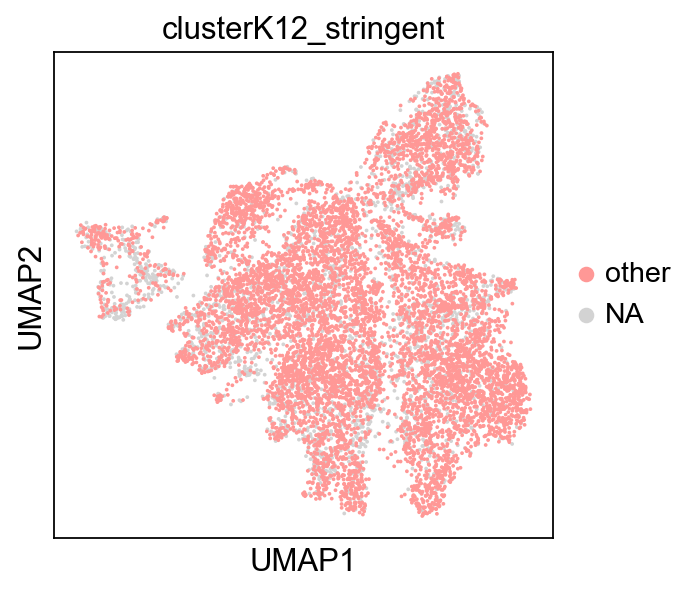

In [155]:
for x in adata_log_ordered.obs.clusterK12_stringent.cat.categories:
    # skip if NA
    sc.pl.umap(adata_log_ordered, color='clusterK12_stringent', groups=[x])

In [156]:
adata_log_ordered.obs.clusterK12.value_counts()

clusterK12
5     2027
8     1729
2     1642
1     1384
9     1089
4      687
3      568
7      407
11     332
12     226
6      177
10     143
Name: count, dtype: int64

In [157]:
cancerCell = ['Cluster 1', 'Cluster 2','Cluster 3','Cluster 4','Cluster 5','Cluster 6', 'Cluster 7', 
              'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12']
#sc.pl.violin(adata_log_ordered, cancerCell, groupby='clusterK12')

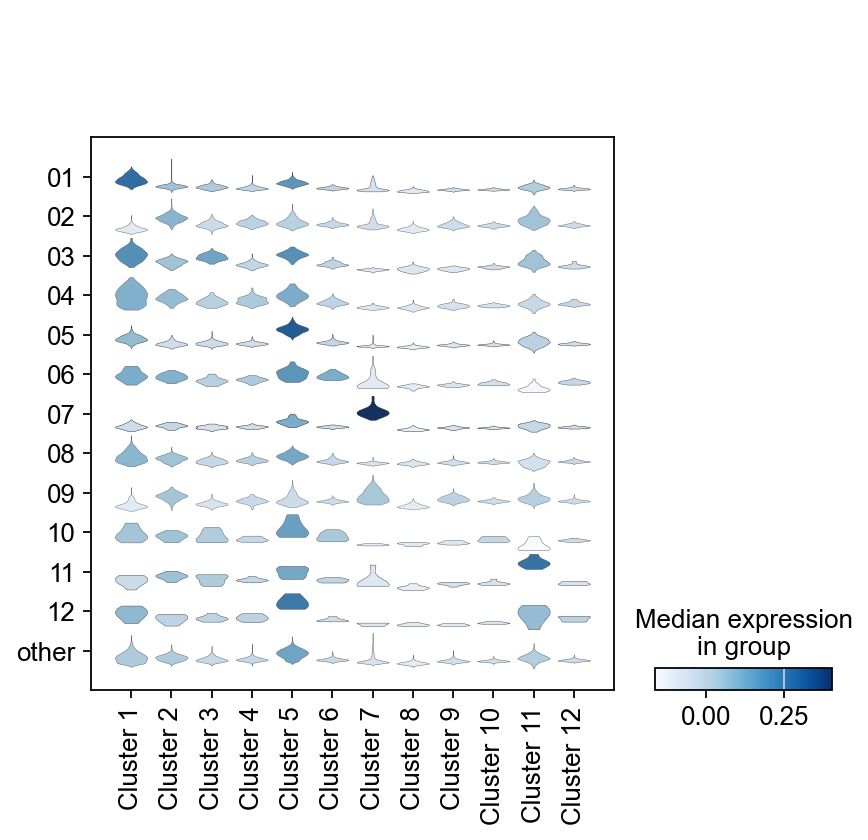

In [158]:
sc.pl.stacked_violin(adata_log_ordered, cancerCell, groupby='clusterK12_stringent')

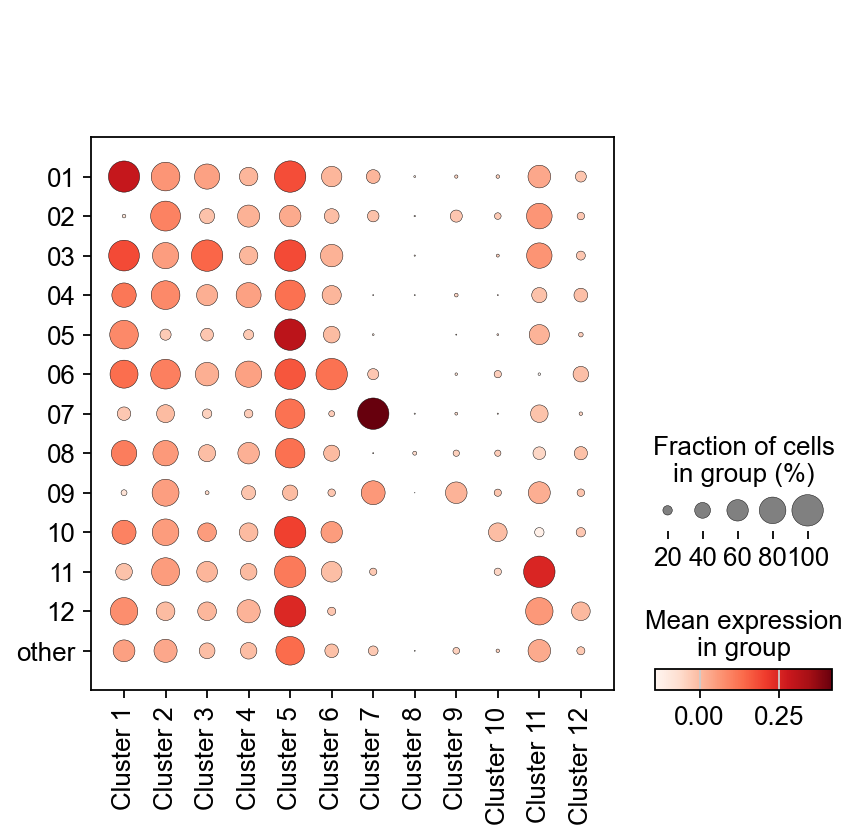

In [159]:
sc.pl.dotplot(adata_log_ordered, [*cancerCell], groupby='clusterK12_stringent')

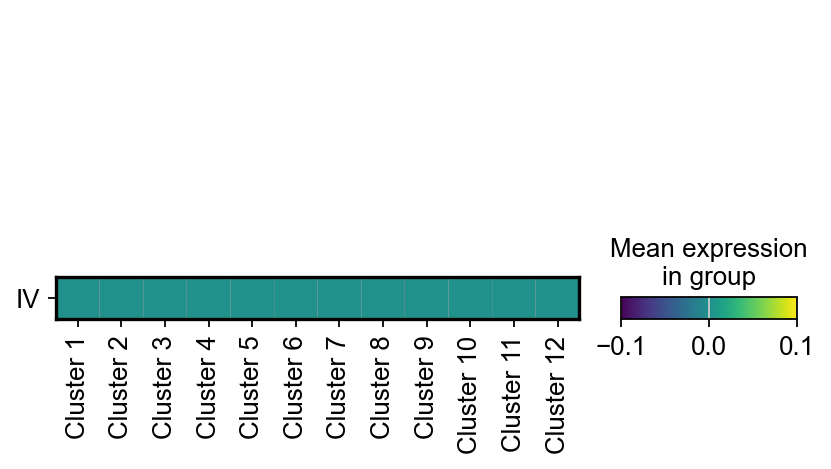

In [160]:
sc.pl.matrixplot(adata_log_ordered, [*cancerCell], groupby='Classification',standard_scale='var')

In [161]:
adata.obs['clusterK12'] = adata_log_ordered.obs['clusterK12'].astype('category')
adata.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

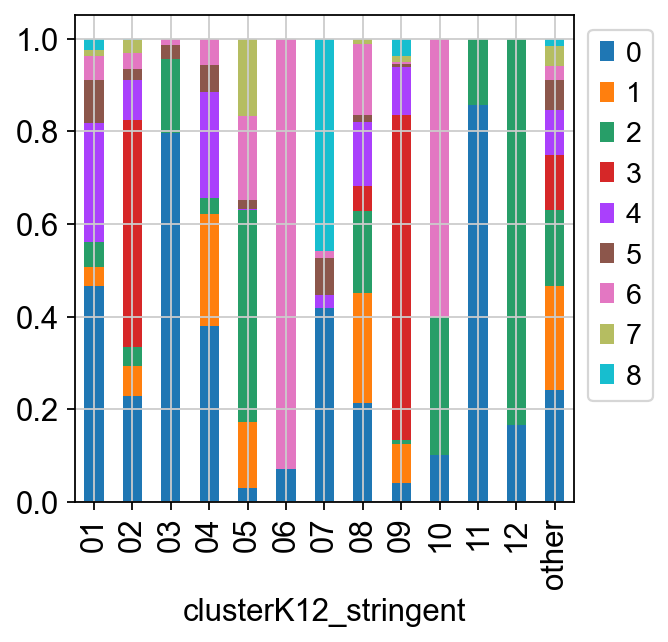

In [162]:
 cell_proportion_df = pd.crosstab(adata.obs['leiden'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

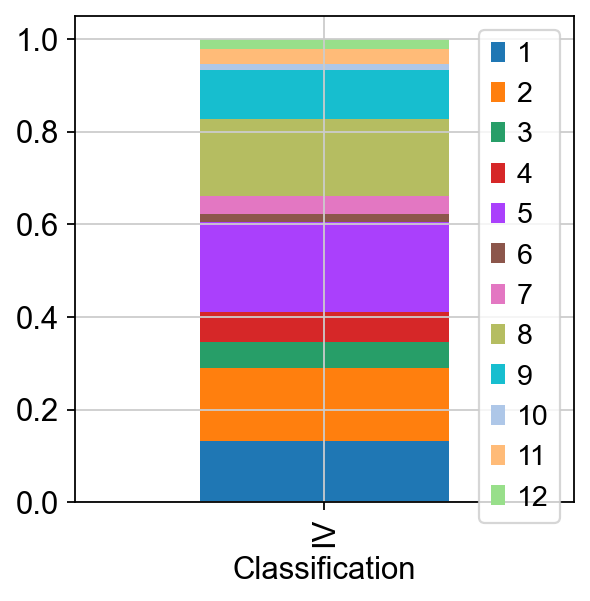

In [163]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata_log_ordered.obs['Classification'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

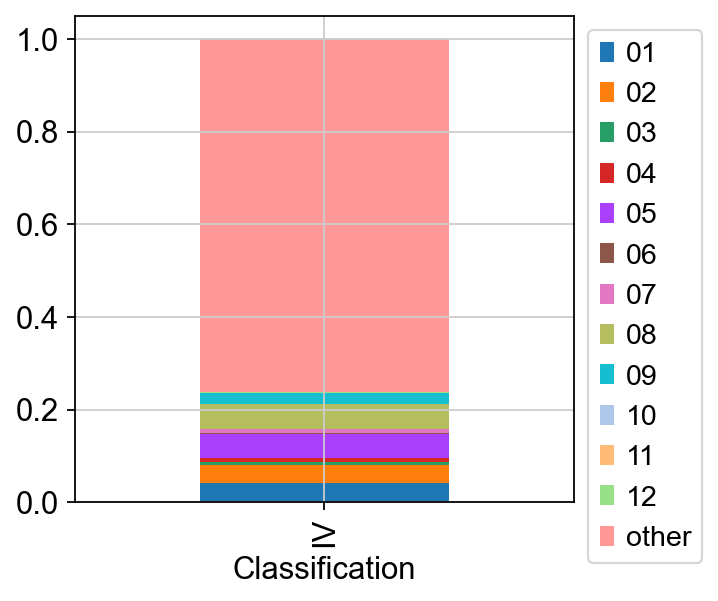

In [164]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12_stringent'],adata_log_ordered.obs['Classification'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

## Examine Groupings

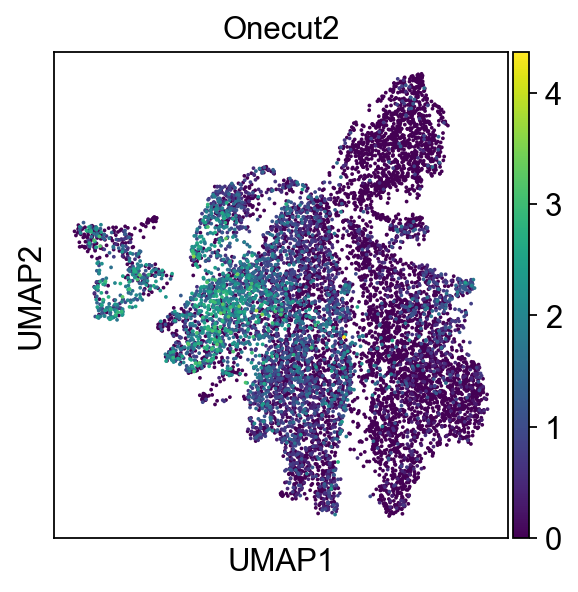

In [165]:
sc.pl.umap(adata, color=['Onecut2'])

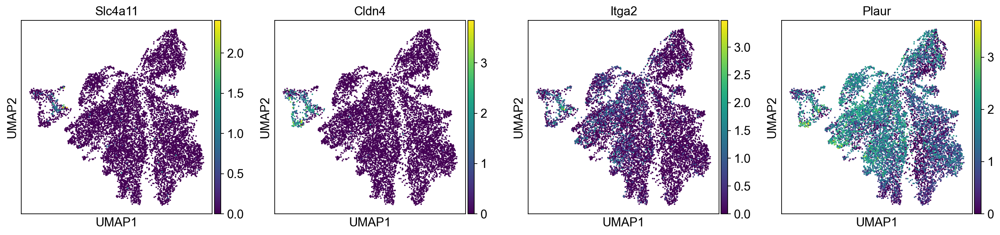

In [166]:
sc.pl.umap(adata, color=['Slc4a11','Cldn4','Itga2', 'Plaur']) #'Tigit',

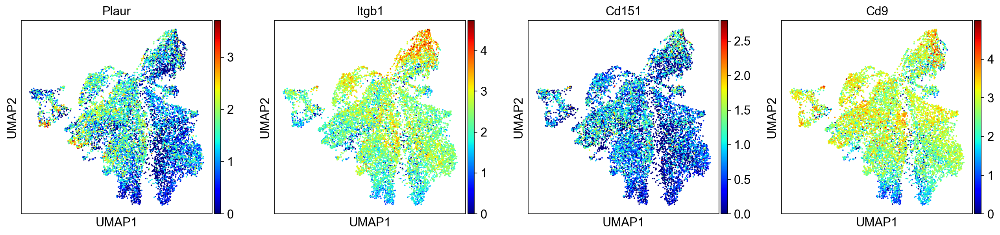

In [167]:
sc.pl.umap(adata, color=['Plaur','Itgb1','Cd151', 'Cd9'], cmap="jet")

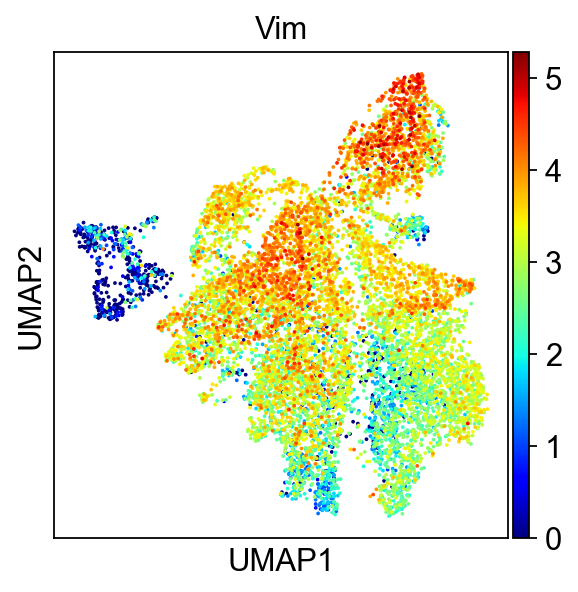

In [168]:
sc.pl.umap(adata, color=['Vim',], cmap="jet") #'Cd109'

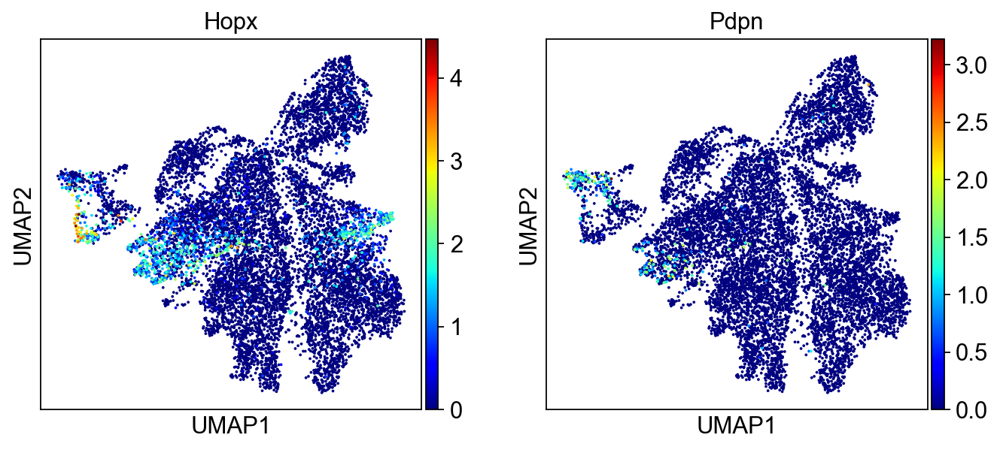

In [169]:
sc.pl.umap(adata, color=['Hopx','Pdpn'], cmap="jet")

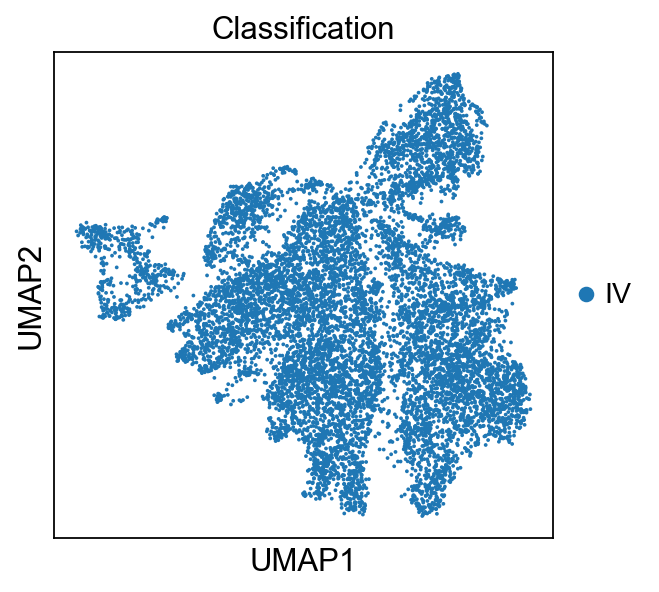

In [170]:
for label in adata.obs['Classification'].unique():
    sc.pl.umap(adata, color='Classification',groups=[label])

In [171]:
adata.obs.Group.value_counts()

Group
DT    10411
Name: count, dtype: int64

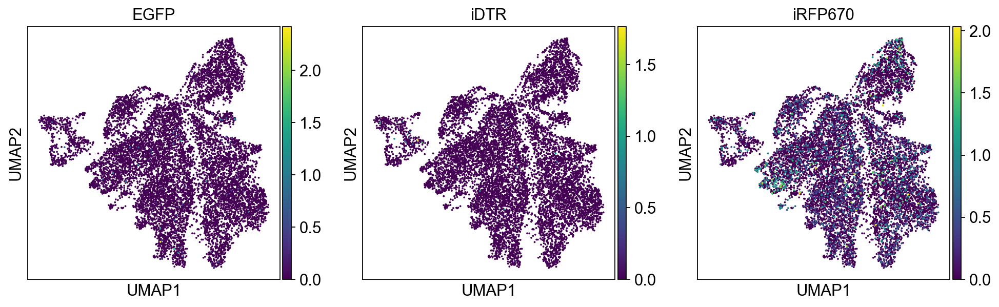

In [172]:
sc.pl.umap(adata, color=['EGFP','iDTR','iRFP670'])

In [173]:
adata.obs["clusterK12"] = adata.obs["clusterK12"].astype(str).str.zfill(2).astype("category")

In [174]:
adata.obs.Classification.value_counts()

Classification
IV    10411
Name: count, dtype: int64

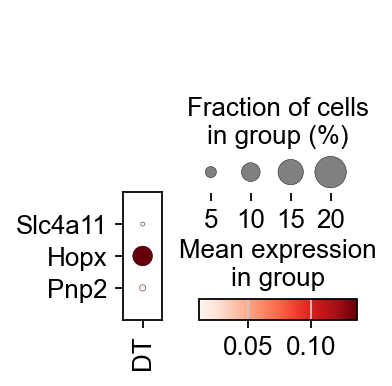

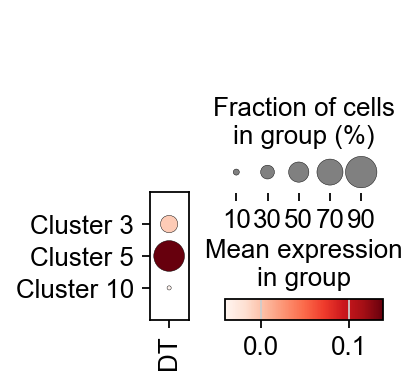

In [175]:
sc.pl.dotplot(adata, ['Slc4a11', 'Hopx','Pnp2'], groupby='Group',swap_axes=True)
sc.pl.dotplot(adata, ['Cluster 3', 'Cluster 5','Cluster 10'], groupby='Group',swap_axes=True)

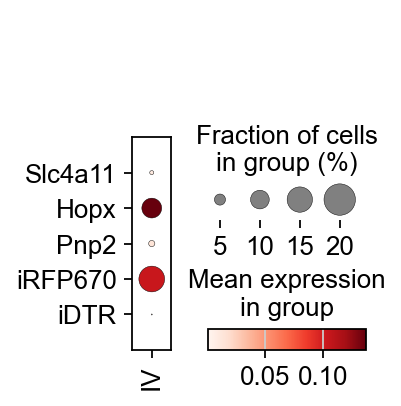

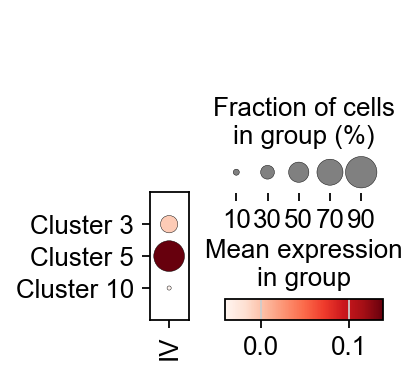

In [176]:
sc.pl.dotplot(adata, ['Slc4a11', 'Hopx','Pnp2','iRFP670','iDTR'], groupby='Classification',swap_axes=True)
sc.pl.dotplot(adata, ['Cluster 3', 'Cluster 5','Cluster 10'], groupby='Classification',swap_axes=True)

In [177]:
sc.tl.leiden(adata, resolution=.20)
#sc.pl.umap(adata, color=['leiden','Slc4a11','Cluster 5', 'clusterK12'], cmap='Reds')
#sc.pl.umap(adata, color=['leiden','Hopx','Cluster 3', 'clusterK12'], cmap='Reds')

running Leiden clustering
    finished: found 6 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


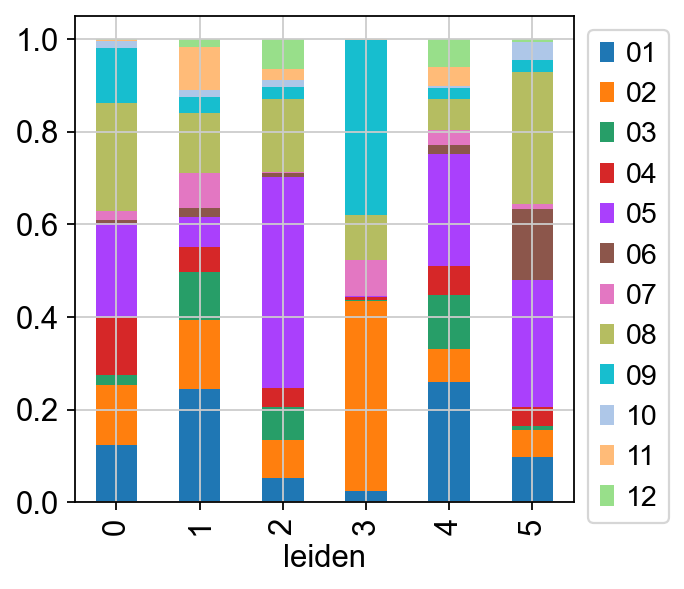

In [178]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata.obs['leiden'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

ValueError: zip() argument 2 is longer than argument 1

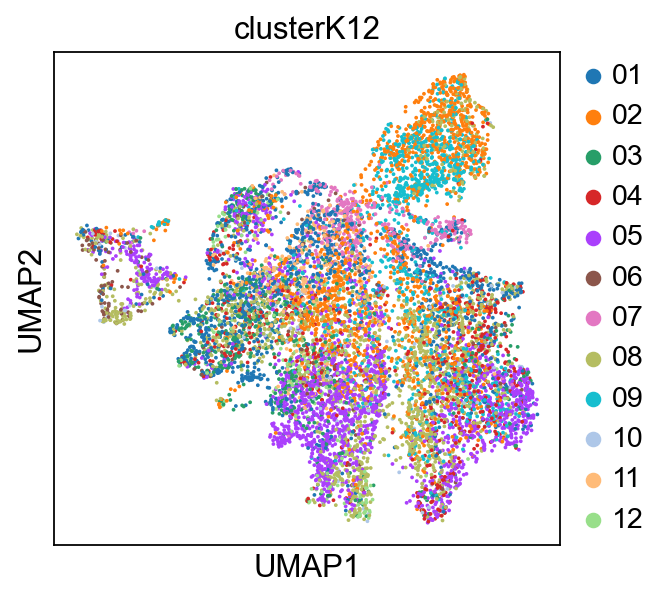

In [179]:
cluster2annotation = {
    "0": "AT2-like",
    "1": "HPCS",
    "2": "Ribosome",
    "3": "AT2-like",
    "4": "HPCS",
    "5": "AT1-like",
    "6": "Highly proliferative",
    "7": "AT2-like",
    "8": "Ribosome",
    "9": "AT1-like",
    "10": "Embryonic liver-like"
}
#"AT1-like","AT2-like",'EMT', 'HPCS',"Lung Endoderm-like",'Highly Proliferative','Embryonic liver-like'
#adata.uns['cell type_colors'] = ['#1f77b4','#279e68', '#ff7f0e', '#d62728', '#8c564b','#e377c2', '#aa40fc']

adata.obs["cell type"] = adata.obs["leiden"].map(cluster2annotation).astype("category")
#adata.obs['cell type'] = adata.obs['cell type'].cat.reorder_categories(['AT1-like', 'AT2-like', 'Embryonic liver-like','HPCS'], ordered=True)
adata.uns['cell type_colors'] = ['#1f77b4','#279e68', '#aa40fc','#d62728','#e377c2','grey' ] #'#ff7f0e' EMT,'#e377c2' lung endoderm, '#8c564b' highly proliferative

sc.pl.umap(adata, color=['clusterK12','cell type'])

In [ ]:
sc.pl.umap(adata, color=['Slc4a11','Nkx2-1','Hnf4a','Hmga2','Hopx','Itga2','Epha2'], cmap='Reds')

In [ ]:
sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)
sc.pl.rank_genes_groups_dotplot(adata, n_genes=5, groupby="leiden")

In [ ]:
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
results_df = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals_adj','scores','logfoldchanges']})
results_df.to_excel('leiden_enriched_genes.xlsx')
results_df

## End here

## Calculate PV

## Figures for paper

# Save the result

In [ ]:
adata.write(results_file, compression='gzip')